In [38]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
import gc #garbage collector

In [3]:
df=pd.read_excel('C:/Users/Octavio/Documents/trabajos manu/Gastronomia/Argumento Jockey golf/DS/ventas por ticket.xls')

In [4]:
item=pd.read_excel('C:/Users/Octavio/Documents/trabajos manu/Gastronomia/Argumento Jockey golf/DS/ventas por item.xls')

### Preprocesamiento del Dataset
El dataset fue extraido de la base de datos del software que utiliza el restaurante.

Tenemos dos datasets:
- Ventas por ticket donde encontramos todos los datos
- ITEM donde encontramos los codigos y las descripciones de los platos

#### ITEM

In [5]:
item=item.drop([0,1,2])
item.columns=['codigo','descrip']
item

,codigo,descrip
3,1,desayuno clasico ...
4,2,Desayuno Light ...
5,3,Desayuno Energetico ...
6,4,Desayuno Proteico ...
7,5,Desayuno Frances ...
...,...,...
313,420,EVENTO LUZ ...
314,422,SOSA GALLARDO ...
315,423,COLEGIO DE ABOGADOS ...
316,424,tostada ...


Unificamos texto transformando todo a minúscula y sacando palabras con acentos

In [6]:
item['descrip']=item.descrip.str.lower()
item['descrip']=item['descrip'].str.replace(u'á','a')
item['descrip']=item['descrip'].str.replace(u'é','e')
item['descrip']=item['descrip'].str.replace(u'í','i')
item['descrip']=item['descrip'].str.replace(u'ó','o')
item['descrip']=item['descrip'].str.replace(u'ú','u')

#### DF
Dataset con todos los datos.


In [7]:
df.columns=['codigo', 'descrip', 'cantidad', 'precio', 'iva', 'tipo', 'prefijo',
       'ticket', 'total', 'fecha', 'fecha_cont', 'hora', 'cajero', 'camarero']
df=df.drop(columns=['iva','tipo','prefijo'])


In [8]:
## Sacamos mayusculas y acentos de nombres de platos
df['descrip']=df.descrip.str.lower()
df['descrip']=df['descrip'].str.replace(u'á','a')
df['descrip']=df['descrip'].str.replace(u'é','e')
df['descrip']=df['descrip'].str.replace(u'í','i')
df['descrip']=df['descrip'].str.replace(u'ó','o')
df['descrip']=df['descrip'].str.replace(u'ú','u')


In [9]:
## Creamos columna de facturado por plato (p * q)
df['facturado_plato']=df.cantidad*df.precio

In [10]:
##pasamos fecha a datetime
from datetime import datetime, timedelta

#Creo columna nueva
df['fecha_completa']=df.fecha.astype(str)+' ' + df.hora

#Paso a datetime
df['fecha_completa']=pd.to_datetime(df['fecha_completa'],format='%Y/%m/%d %H:%M:%S')

#Dropeo columnas viejas
df=df.drop(columns=['fecha','fecha_cont','hora'])

#Cambio nombre a columna nueva
df=df.rename(columns={'fecha_completa':'fecha'})

#Creo columna con nombre del dia de la semana
df['dia']=df.fecha.dt.day_name()

Creamos clasificacion por hora de: Mañana, mediodia, tarde, noche

In [11]:
mask_morning=np.logical_and(df.fecha.dt.hour>=7,df.fecha.dt.hour<=11)
mask_mediodia=np.logical_and(df.fecha.dt.hour>=12,df.fecha.dt.hour<=15)
mask_tarde=np.logical_and(df.fecha.dt.hour>=16,df.fecha.dt.hour<=19)
mask_noche=np.logical_or(df.fecha.dt.hour>=20,df.fecha.dt.hour<=4)
df.loc[mask_morning,'turno']='Morning [7-12]'
df.loc[mask_mediodia,'turno']='Mediodia [12-16]'
df.loc[mask_tarde,'turno']='Tarde [16-20]'
df.loc[mask_noche,'turno']='Noche [21-end]'


Buscaremos un criterio para eliminar descripciones que no tienen sentido.

In [12]:
codigos=pd.pivot_table(data=df,index=['codigo','descrip'],values='cantidad',aggfunc='count').reset_index()

In [13]:
codigos_corregir=np.array(codigos[codigos.codigo.duplicated(keep=False)].codigo.unique())
codigos_corregir.size

68

Para corregir estos codigos y trabajar sobre los nombres de los platos
### Creamos un nuevo codigo para todos los platos y trabajamos para unificar los que son iguales

In [14]:
codigos['codigo']=np.arange(1,len(codigos)+1)

In [15]:
##PARA CREAR EL DICCIONARIO VISUALIZAMOS:

#for idx, desc in enumerate(codigos.descrip):
#    print(idx,desc)

In [16]:
#PARA ARMAR LISTAS DE CADA CATEGORIA UTILIZAMOS ESTOS ARRAYS

np.array(codigos.descrip.iloc[18:31])
np.array(codigos[codigos.descrip.str.contains('papas')].descrip)
np.array(codigos[codigos.descrip.str.contains('baguette')].descrip)
np.array(codigos[codigos.descrip.str.contains('milanesa')].descrip)
np.array(codigos[codigos.descrip.str.contains('pollo')].descrip)
np.array(codigos[codigos.descrip.str.contains('ensalada')].descrip)
np.array(codigos[codigos.descrip.str.contains('wrap')].descrip)
np.array(codigos[codigos.descrip.str.contains('suprema')].descrip)
np.array(codigos[codigos.descrip.str.contains('salmon')].descrip)
np.array(codigos[codigos.descrip.str.contains('ris')].descrip)
np.array(codigos[codigos.descrip.str.contains('matambre')].descrip)
np.array(codigos[codigos.descrip.str.contains('hamburguesa')].descrip)
np.array(codigos[codigos.descrip.str.contains('veggie')].descrip)
np.array(codigos[codigos.descrip.str.contains('lom')].descrip)
np.array(codigos[codigos.descrip.str.contains('emp')].descrip)
np.array(codigos[codigos.descrip.str.contains('agua')].descrip)
np.array(codigos[codigos.descrip.str.contains('cola')].descrip)
np.array(codigos[codigos.descrip.str.contains('fanta')].descrip)
np.array(codigos.descrip.iloc[129:150])
np.array(codigos.descrip.iloc[102:112])
np.array(codigos[codigos.descrip.str.contains('sand')].descrip)
np.array(codigos.descrip.iloc[153:162])
np.array(codigos[codigos.descrip.str.contains('caf')].descrip)
np.array(codigos[codigos.descrip.str.contains('desayuno')].descrip)
np.array(codigos[codigos.descrip.str.contains('coca')].descrip)
np.array(codigos[codigos.descrip.str.contains('limonada')].descrip)
np.array(codigos[codigos.descrip.str.contains('de papa')].descrip)
np.array(codigos[codigos.descrip.str.contains('infantil')].descrip)


array(['menu infantil suprema', 'menu infantil pasta'], dtype=object)

In [17]:
## ARMAMOS DICCIONARIO CON CLASIFICACIONES 
## Lo armamos copiando arrays generados en la celda anterior y pegandolos en cada clase creada. Si se actualiza la tabla deberiamos agregar cualquier plato que quede fuera de una clase.

clasificaciones={'cafe':['cafe chico', 'cafe jarrito', 'cafe chico', 'cafe doble','caf‚ chico', 'cafe jarrito', 'caf‚ jarrito', 'cafe doble','caf‚ doble'],
      'desayunos':['desayuno clasico', 'desayuno light', 'desayuno energetico','desayuno proteico', 'desayuno frances', 'desayuno fit not fat','desayuno finoli'],
      'otros_desayuno':['barra de cereal clasica','te', 'medialunas', 'submarino', 'criollos', 'te', 'medialunas','tostadas de campo', 'criollos', 'mafaldas', 'torta porcion', 'yogurt c/fruta'],
     'bebidas frias':['limonada vaso', 'limonada en vaso', 'limonada jarra','limonada en jarra','jugo de naranja','licuado'],
      'papas':['papas clasicas', '** papas clasicas', 'papas clasicas','papas con cheddar', '** papas cheese', 'papas cheese','papas con revuelto', '** papas con revuelto','papas con revuelto'],
      'picoteo':['milanesa cortada','tabla de fiambres'],
      'baguette':['baguette cocido', 'baguette crudo', 'baguette cocido con papa','baguette cocido con papas', 'baguette ternera','baguette crudo con papas', 'baguette salame','baguette ternera con pap', 'baguette ternera con papas','baguette salame con papa', 'baguette salame con papas'],
      'ojo de bife':['ojo de bife'],
      'milanesa':['milanesa clasica','milanesa napolitana', 'milanesa a caballo', '** milanesa clasica','milanesa clasica', 'milanesa napolitana', 'milanesa a caballo','milanesa suiza'],
      'suprema':['suprema clasica', 'suprema napolitana', 'suprema clasica','suprema napolitana', 'suprema a caballo', 'suprema suiza'],
      'pollo':['pollo al champignon', 'pollo deshuesado a la mo', 'pollo deshuesado a la mostaza'],
      'ensalada':['ensalada salmon', 'ensalada caesar', 'ensalada marina', 'ensalada azul', 'ensalada caesar', 'ensalada de salmon'],
      'wrap':['wrap negro', 'wrap pollo', 'wrap rojo', 'wrap veggie','wrap verde', 'wrap integral', 'wrap ternera'],
      'matambre':['matambre de cerdo'], 
      'salmon': ['** salmon rosado', 'salmon rosado'],
      'rissoto': ['rissotto de hongos', 'rissoto de yamani', 'rissoto hongos'] ,
      'hamburguesa':['hamburguesa clasica', 'hamburguesa cheese bacon', '** hamburguesa clasica','hamburguesa clasica', 'hamburguesa cheese bacon'] ,
      'hamburguesa veggie':['hamburguesa veggie', 'hamburguesa veggie'],
      'pastas':  ['¥oquis de papa', 'ñoquis de papa','ravioles de osobuco','ravioles de verdura','sorrentinos de jamon y queso','sorrentinos de calabaza y muzarella', 'sorrentinos de hongos','sorrentinos calabaza', 'ñoquis', 'ravioles osobuco'],
      'lomo' :['lomito argumento', 'lomo argumento', 'lomo ruculento'],
      'empanada': ['** empanada osobuco', 'empanada osobuco', '** empanada matambre','empanada matambre', 'empanada verdura', 'empanada jamon y queso','empanada criolla', 'empanada matambre', 'empanada jamon y queso'] ,
      'pizza':   ['muzarella',  'especial', '** muzarella','muzarella', 'rucula', 'especial', 'hongos', '** rucula','napolitana', 'rucula', 'fugazzeta', 'hongos', '4 quesos','napolitana', 'fugazzeta', '4 quesos','vegetariana', 'azul'],
      'sandwich':['sandwich argumento'],
      'postre':['vigilante', '** flan clasico', 'flan clasico','flan clasico completo', 'panqueque', 'blondi', 'bocha de helado','coca cola 500cc', 'higos en almibar'],
      'agua': ['** agua con gas', 'agua con gas', '** agua sin gas','agua sin gas'] ,
      'cola': ['cola zero 500 cc','coca cola 500cc', '** coca cola', '** coca cola 500ml','coca cola', 'coca cola 500ml', '** coca zero 500ml', 'coca zero','coca zero 500ml'] ,
      'fanta':  ['fanta 500 cc', 'fanta zero 500 cc'] ,
      'menu infantil':['menu infantil suprema', 'menu infantil pasta'],
      'otros_acompanantes':['** pure de rucula','salsa 4 quesos']
      }
#clasificaciones

In [18]:
## CREAMOS COLUMNA CLASE
codigos['clase']=codigos.descrip

##REEMPLAZAMOS VALORES DE PLATOS POR CLASES EN COLUMNA CLASE
for clase in clasificaciones:
    for plato in clasificaciones[clase]:
        codigos['clase']=codigos.clase.replace(plato,clase)


Unificamos Dataframes en uno solo con los codigos nuevos y las clases

In [19]:
codigos
df2=df.merge(codigos.drop(columns='cantidad'),how='left',left_on='descrip',right_on='descrip')
df2=df2.drop(columns=['codigo_x'])
df2=df2.rename(columns={'codigo_y':'codigo'})
df2

,descrip,cantidad,precio,ticket,total,cajero,camarero,facturado_plato,fecha,dia,turno,codigo,clase
0,desayuno clasico,1,250,5714,740.0,3,11,250,2020-12-09 19:23:25,Wednesday,Tarde [16-20],2,desayunos
1,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:10,Wednesday,Morning [7-12],2,desayunos
2,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:14,Wednesday,Morning [7-12],2,desayunos
3,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:15,Wednesday,Morning [7-12],2,desayunos
4,desayuno clasico,1,240,2851,880.0,2,6,240,2020-11-18 09:34:06,Wednesday,Morning [7-12],2,desayunos
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21578,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 14:09:34,Sunday,Mediodia [12-16],175,cola
21579,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 14:09:34,Sunday,Mediodia [12-16],175,cola
21580,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 15:02:56,Sunday,Mediodia [12-16],175,cola
21581,coca zero,1,110,2651,3780.0,3,12,110,2020-11-15 15:22:14,Sunday,Mediodia [12-16],175,cola


### Realizamos analisis exploratorio sobre este dataset

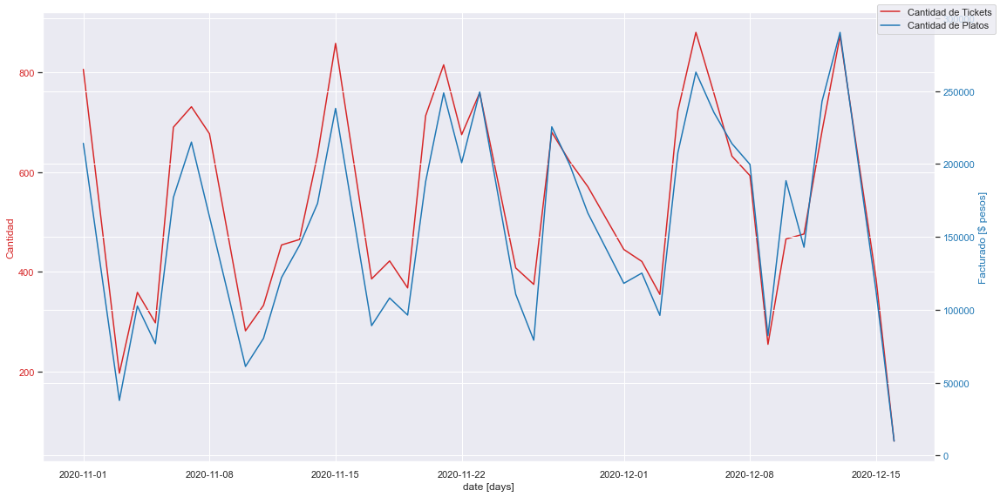

In [20]:
fig, ax1 = plt.subplots(figsize=(16,8))

color = 'tab:red'
color2 = 'tab:green'
ax1.set_xlabel('date [days]')
ax1.set_ylabel('Cantidad', color=color)
ax1.plot(df2.groupby(df2['fecha'].dt.date).ticket.count(), label='Cantidad de Tickets', color=color)
#ax1.plot(df2.groupby(df2['fecha'].dt.date).cantidad.sum(),label='Cantidad de Platos',color=color2)
ax1.tick_params(axis='y', labelcolor=color)


ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('Facturado [$ pesos]', color=color)  # we already handled the x-label with ax1
ax2.plot(df2.groupby(df2['fecha'].dt.date).facturado_plato.sum(),label='Cantidad de Platos', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()# otherwise the right y-label is slightly clipped
fig.legend()
plt.show()

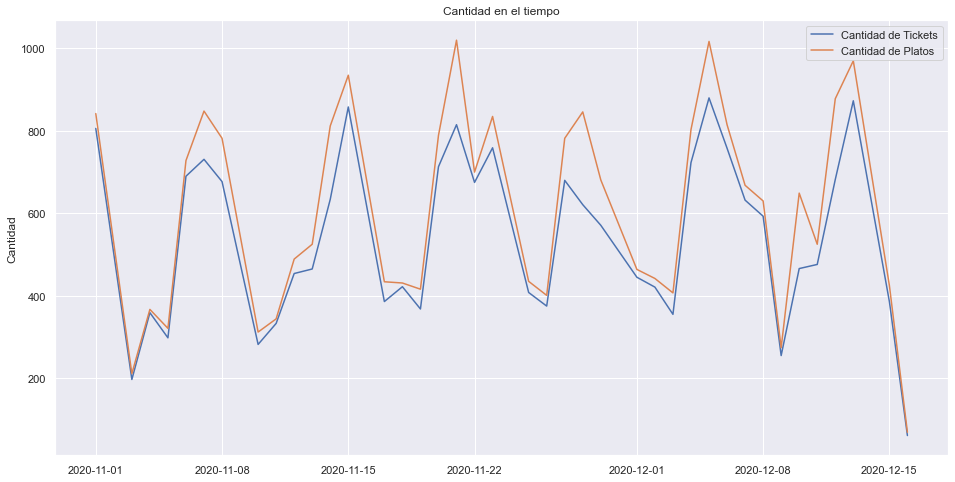

In [21]:
plt.figure(figsize=(16,8))
plt.title('Cantidad en el tiempo' )
plt.plot(df2.groupby(df2['fecha'].dt.date).ticket.count(), label='Cantidad de Tickets')
plt.plot(df2.groupby(df2['fecha'].dt.date).cantidad.sum(),label='Cantidad de Platos')
plt.ylabel('Cantidad')

plt.legend()
plt.show()

In [22]:
semana=np.array(['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday', 'Sunday'])

In [23]:
df2.groupby('dia').ticket.count().reindex(semana)

dia
Monday       1391
Tuesday      2289
Wednesday    2259
Thursday     2316
Friday       3747
Saturday     4363
Sunday       5218
Name: ticket, dtype: int64

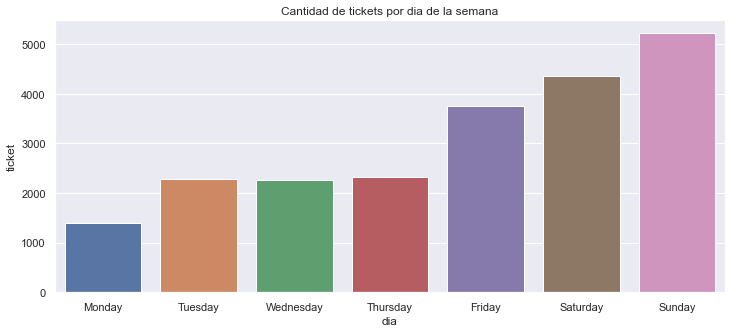

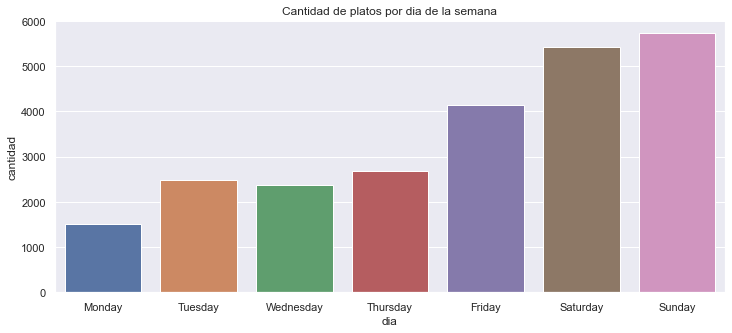

In [24]:
plt.figure(figsize=(12,5))
plt.title('Cantidad de tickets por dia de la semana')
sns.barplot(x=df2.groupby('dia').ticket.count().reindex(semana).index,y=df2.groupby('dia',sort=True).ticket.count().reindex(semana))
plt.show()
plt.figure(figsize=(12,5))
plt.title('Cantidad de platos por dia de la semana')
sns.barplot(x=df2.groupby('dia').cantidad.sum().reindex(semana).index,y=df2.groupby('dia',sort=True).cantidad.sum().reindex(semana))
plt.show()

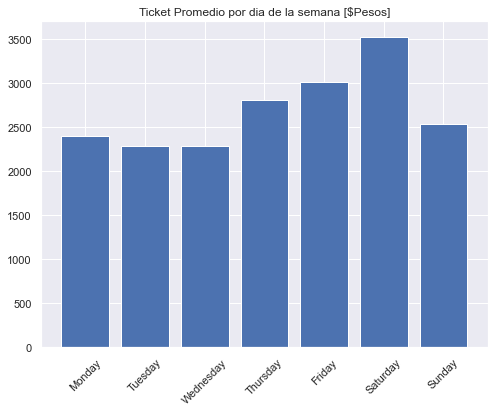

,total
dia,
Monday,2392.875629
Tuesday,2277.673779
Wednesday,2283.470598
Thursday,2803.181796
Friday,3012.528722
Saturday,3520.122634
Sunday,2535.306631


In [25]:
plt.figure(figsize=(8,6))
plt.title('Ticket Promedio por dia de la semana [$Pesos]')
plt.bar(x=df2.groupby('dia').total.mean().reindex(semana).index,height=df2.groupby('dia').total.mean().reindex(semana))
plt.xticks(rotation=45)
plt.show()
df2.groupby('dia')[['total']].mean().reindex(semana)

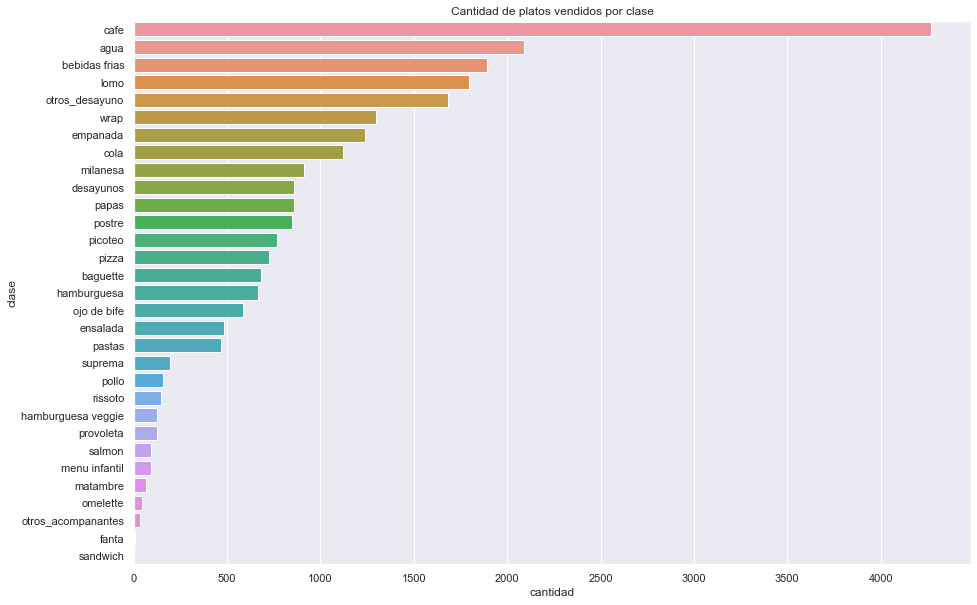

In [26]:
plt.figure(figsize=[15,10])
plt.title('Cantidad de platos vendidos por clase')
df2.groupby('clase').cantidad.sum().sort_values(ascending=False)
sns.barplot(y=df2.groupby('clase').cantidad.sum().sort_values(ascending=False).index,x=df2.groupby('clase').cantidad.sum().sort_values(ascending=False))

plt.show()

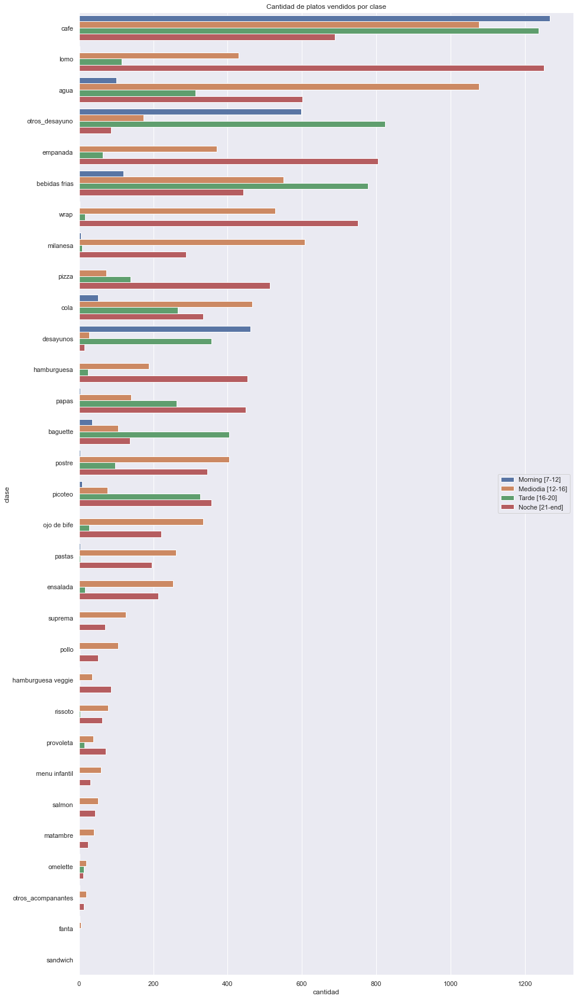

In [27]:
graf=df2.groupby(['clase','turno']).cantidad.sum().sort_values(ascending=False).reset_index()

plt.figure(figsize=[15,30])
plt.title('Cantidad de platos vendidos por clase')
df2.groupby('clase').cantidad.sum().sort_values(ascending=False)
sns.barplot(data=graf,y='clase',x='cantidad',hue='turno',hue_order=['Morning [7-12]', 'Mediodia [12-16]','Tarde [16-20]','Noche [21-end]'])
plt.legend()
plt.show()

In [28]:
graf=df2.groupby(['clase','turno','dia']).cantidad.sum().sort_values(ascending=False).reset_index()
graf
semana=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday',
       'Sunday']

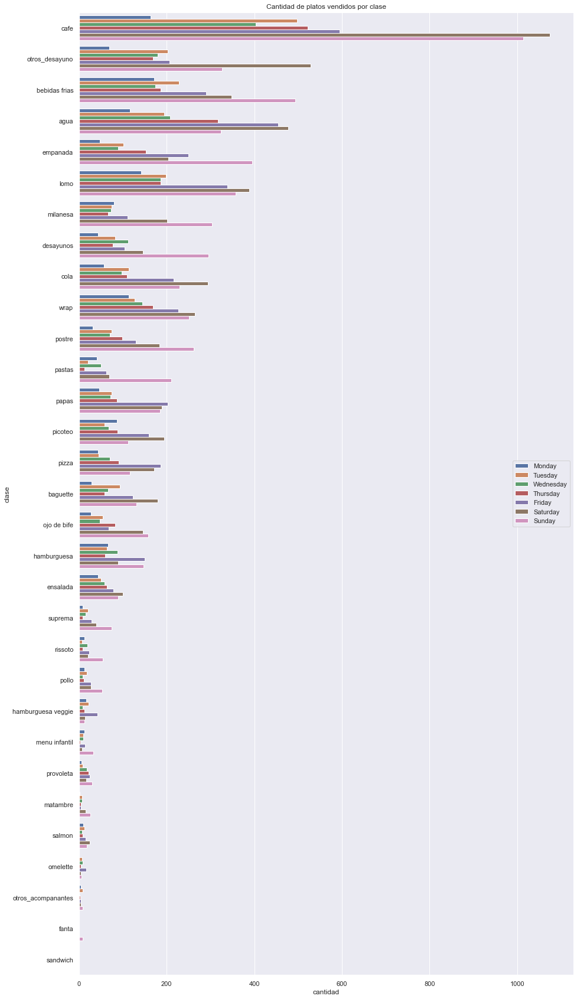

In [29]:
graf=df2.groupby(['clase','dia']).cantidad.sum().sort_values(ascending=False).reset_index()


plt.figure(figsize=[15,30])
plt.title('Cantidad de platos vendidos por clase')
sns.barplot(data=graf,y='clase',x='cantidad',hue='dia',hue_order=semana)
plt.legend()
plt.show()

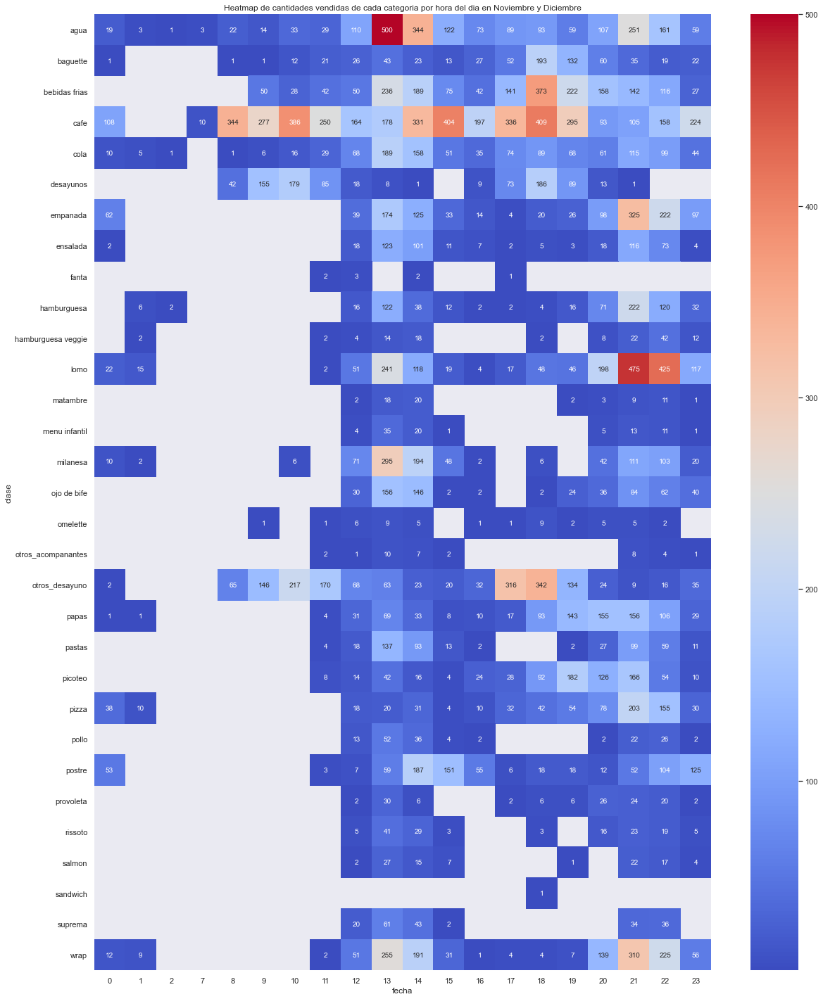

In [30]:
plt.figure(figsize=[20,25])
plt.title('Heatmap de cantidades vendidas de cada categoria por hora del dia en Noviembre y Diciembre')
sns.heatmap(df2.pivot_table(index='clase',columns=df2['fecha'].dt.hour,values='cantidad',aggfunc='sum'),
            cbar = True,  square = True, annot=True, fmt= '.0f',annot_kws={'size': 10}, cmap= 'coolwarm')
plt.show()

Monday


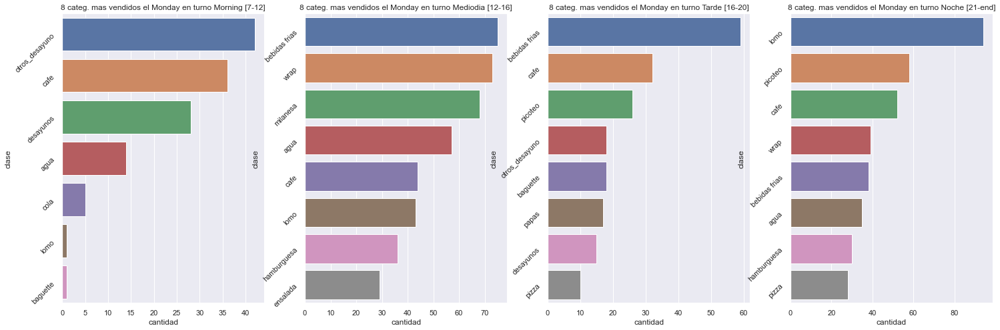

Tuesday


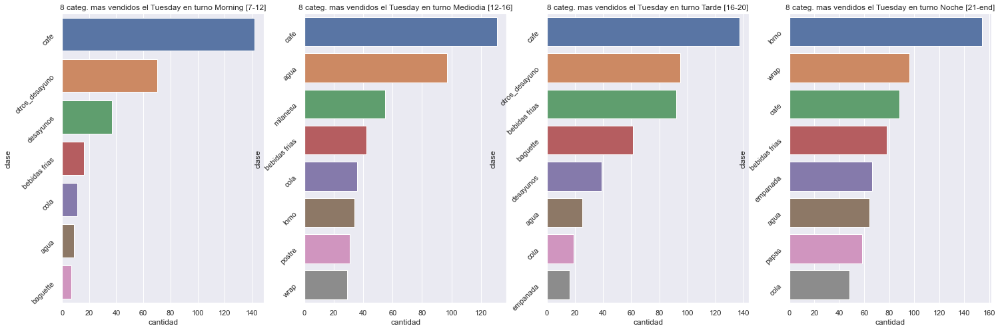

Wednesday


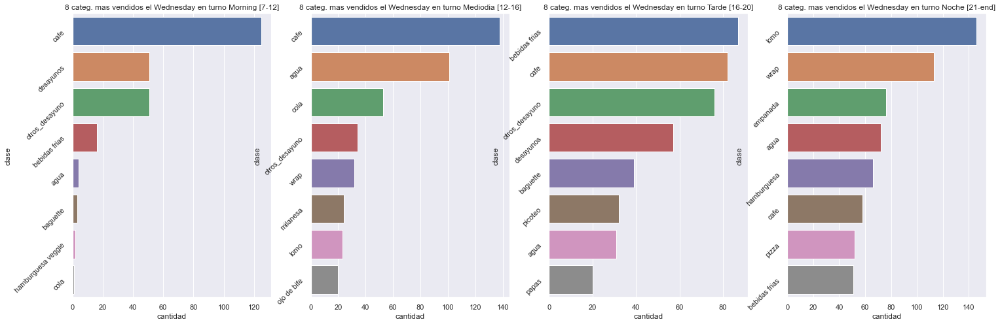

Thursday


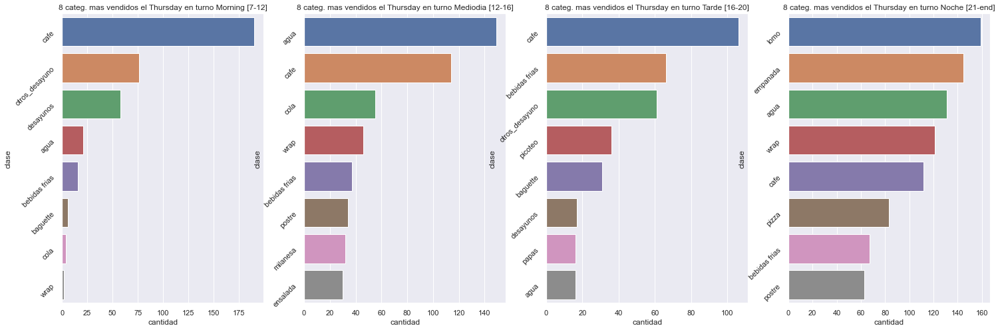

Friday


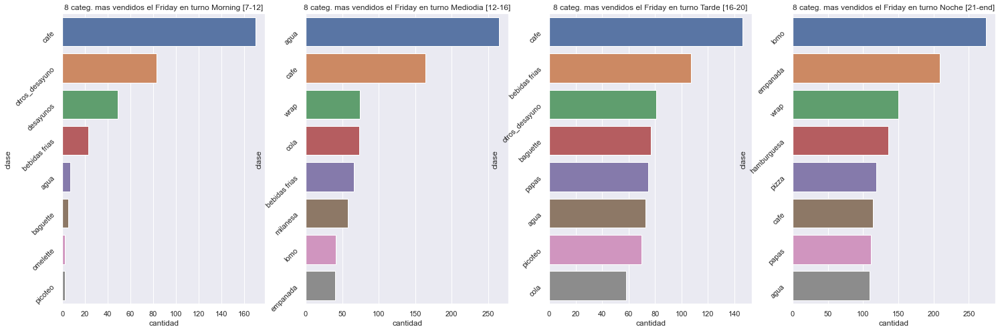

Saturday


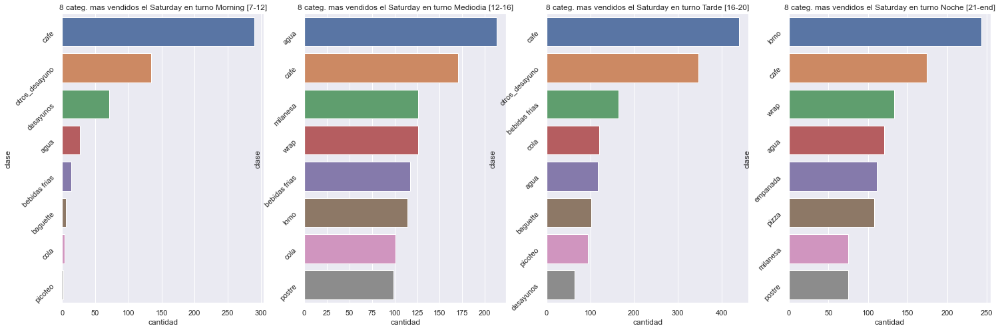

Sunday


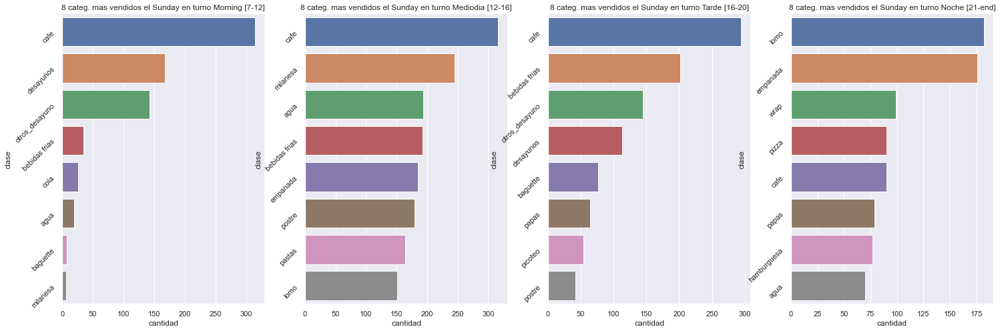

In [32]:
semana=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
turno=['Morning [7-12]', 'Mediodia [12-16]','Tarde [16-20]','Noche [21-end]']
for dia in semana:
    graf=df2.loc[df2.dia==dia].groupby(['clase','turno','dia']).cantidad.sum().sort_values(ascending=False).reset_index()
    print(dia)
    plt.figure(figsize=[25,8])
    
    rotation=45
    
    idx=0
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad')

    idx=1
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad')

    idx=2
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad')

    idx=3
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad')

    plt.show()

Estos gráficos sirvieron mucho para el Marketing del restaurante. Lo cual fue el pedido principal cuando pidieron el estudio, Cuales eran los platos más pedidos por día y por turno.


### Utilizamos esta matriz para crear la matriz de utilidad con clases y con tickets

In [33]:
df2.head()

,descrip,cantidad,precio,ticket,total,cajero,camarero,facturado_plato,fecha,dia,turno,codigo,clase
0,desayuno clasico,1,250,5714,740.0,3,11,250,2020-12-09 19:23:25,Wednesday,Tarde [16-20],2,desayunos
1,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:10,Wednesday,Morning [7-12],2,desayunos
2,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:14,Wednesday,Morning [7-12],2,desayunos
3,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:15,Wednesday,Morning [7-12],2,desayunos
4,desayuno clasico,1,240,2851,880.0,2,6,240,2020-11-18 09:34:06,Wednesday,Morning [7-12],2,desayunos


1. Creo matriz de utilidad (tickets vs platos) 
2. la normalizo dividiendo por la el "modulo" de cada vector por ticket, esto hace que los tickets con muchos platos tengan menos influencia que los tickets con pocos platos
3. Luego calculo los "modulos" de cada vector por plato en la matriz normalizada
4. Creo una matriz que contiene los items en las columnas y filas
5. calculo el Producto punto de todas las parejas de platos y lo divido por el producto de los "modulos" de ambos platos, ese valor es el que va en cada casilla. Este valor es denominado **Similitud Coseno**


In [34]:
utility=pd.pivot_table(data=df2,columns='clase',index='ticket',values='cantidad',aggfunc='sum',fill_value=0)


ticket_magnitude =np.sqrt(np.square(utility).sum(axis=1))

utility_norm=utility.divide(ticket_magnitude, axis='index')



item_magnitude_norm = np.sqrt(np.square(utility_norm).sum(axis=0))



In [35]:
item_item=pd.DataFrame(data=np.zeros([utility_norm.shape[1],utility_norm.shape[1]]),index=utility_norm.columns,columns=utility_norm.columns)

for i in item_item.columns:
    for j in item_item.index:
        dot=np.dot(utility_norm[i].values,utility_norm[j].values)
        euclidean_i=item_magnitude_norm[i]
        euclidean_j=item_magnitude_norm[j]
        value=dot/(euclidean_i*euclidean_j)
        item_item.loc[i,j]=value
item_item

clase,agua,baguette,bebidas frias,cafe,cola,desayunos,empanada,ensalada,fanta,hamburguesa,...,picoteo,pizza,pollo,postre,provoleta,rissoto,salmon,sandwich,suprema,wrap
clase,,,,,,,,,,,,,,,,,,,,,
agua,1.000000,0.057619,0.101460,0.107566,0.099345,0.029029,0.046201,0.124448,0.001498,0.070099,...,0.072269,0.045438,0.082402,0.157431,0.055055,0.084692,0.086120,0.000000,0.049073,0.129957
baguette,0.057619,1.000000,0.164429,0.051572,0.092687,0.060285,0.010159,0.020933,0.000000,0.018923,...,0.018034,0.012809,0.012096,0.012028,0.011649,0.003789,0.000707,0.000000,0.002623,0.025699
bebidas frias,0.101460,0.164429,1.000000,0.079256,0.052982,0.109405,0.043340,0.095365,0.000000,0.063973,...,0.103862,0.041522,0.081488,0.105970,0.040974,0.084776,0.056103,0.000000,0.034129,0.155722
cafe,0.107566,0.051572,0.079256,1.000000,0.059990,0.083579,0.029905,0.063664,0.005937,0.036649,...,0.028510,0.017253,0.034170,0.083310,0.019297,0.038936,0.026427,0.000000,0.019092,0.053884
cola,0.099345,0.092687,0.052982,0.059990,1.000000,0.012225,0.023627,0.050568,0.013757,0.077440,...,0.033530,0.046165,0.037163,0.060301,0.022215,0.032221,0.016365,0.000000,0.038160,0.075749
desayunos,0.029029,0.060285,0.109405,0.083579,0.012225,1.000000,0.001168,0.004154,0.000000,0.004913,...,0.021032,0.004653,0.002760,0.010664,0.006940,0.003554,0.006501,0.000000,0.002534,0.012101
empanada,0.046201,0.010159,0.043340,0.029905,0.023627,0.001168,1.000000,0.039380,0.008658,0.015666,...,0.014637,0.026260,0.023116,0.066365,0.013049,0.034571,0.060383,0.090776,0.021160,0.045545
ensalada,0.124448,0.020933,0.095365,0.063664,0.050568,0.004154,0.039380,1.000000,0.000000,0.051052,...,0.028532,0.016398,0.043786,0.094186,0.027231,0.032197,0.018322,0.000000,0.050397,0.077821
fanta,0.001498,0.000000,0.000000,0.005937,0.013757,0.000000,0.008658,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.040901,0.000000,0.000000,0.000000,0.000000,0.000000,0.001173


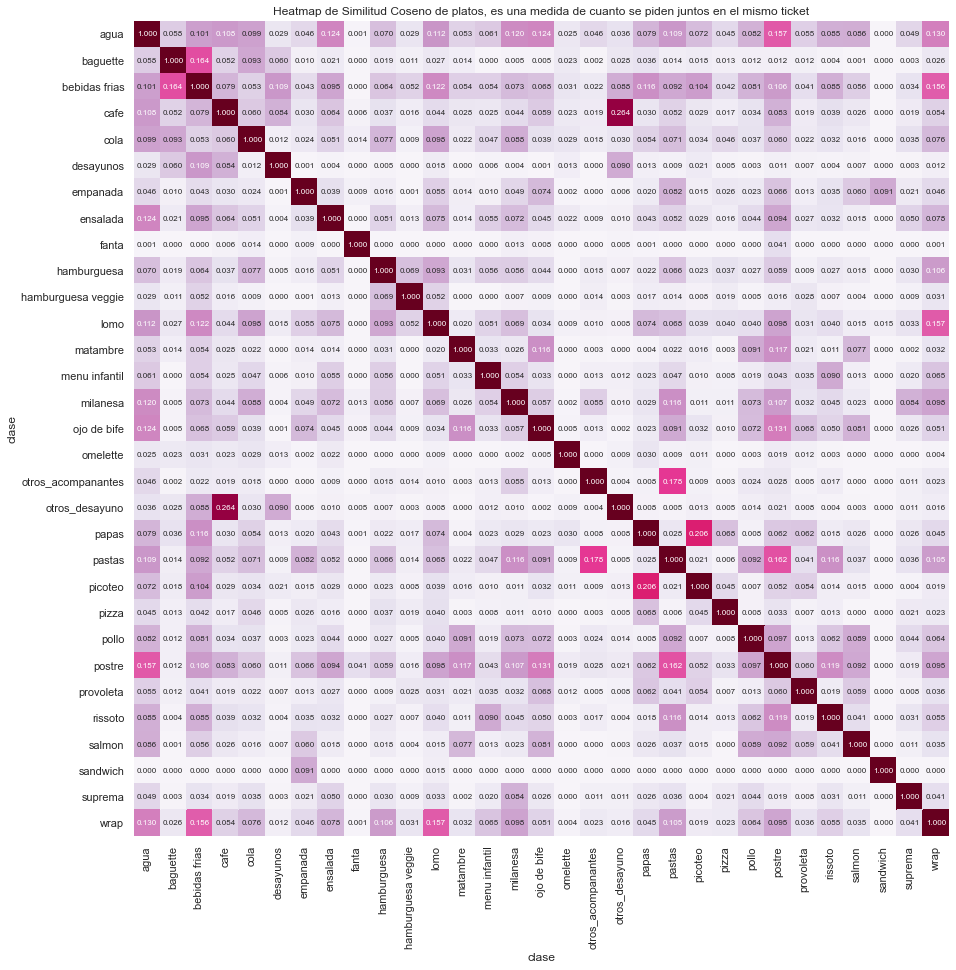

In [36]:
plt.figure(figsize=[15,15])
plt.title('Heatmap de Similitud Coseno de platos, es una medida de cuanto se piden juntos en el mismo ticket')
sns.heatmap(item_item,
            cbar = False,  square = True, annot=True, fmt= '.3f',annot_kws={'size': 8},vmin=0, vmax=0.3,cmap='PuRd')# cmap= 'coolwarm'
plt.show()

De este cuadro se pueden obtener varios INSIGHTS:
- Los postres se suelen pedir con platos más "sofisticados" como ojo de bife, matambre, pastas o salmon.
- Las bebidas frias (limonada sobretodo) se consumen mucho con baguette que es un sandwich de tamaño para merienda, y si revisamos los graficos del análisis exploratorio vemos que esto se suele pedir a la tarde. Hay que considerar que esto aplica para la estación Verano.
- Los Wraps son platos muy versatiles, se piden mucho con varios platos. Con el que más se pide es con el Lomo indicando esto que la combinación de que un cliente come lomo y otro cliente come wrap es algo que suele suceder y se puede aprovechar
- La hamburguesa es uno de los platos más rentables y no es el más pedido (en comparación al Lomo o al Wrap por ejemplo) Podemos ver que en los tickets que se piden lomo y wraps se suelen pedir hamburguesas, por lo que deberia explotarse esto para apalancar la hamburguesa sobre otros platos menos rentables como el lomo.
- Claramente los platos de picoteo se piden mucho con las papas y con las bebidas frías.

Para proseguir con el analisis creamos una herramienta para colocar un plato y obtener los 8 platos que más similitud tienen:

Inserte su plato:   postre


C:\Users\Octavio\miniconda3\envs\datascience\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:title={'center':'postre'}, xlabel='clase', ylabel='postre'>

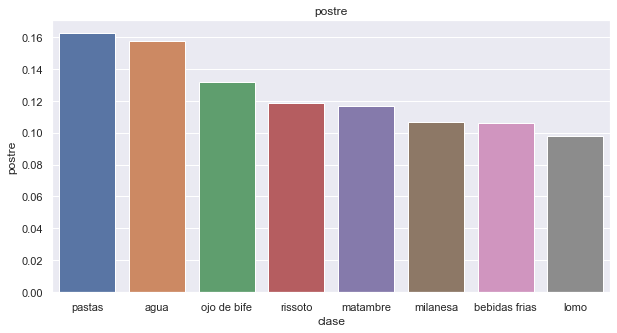

In [37]:
plato=input('Inserte su plato:  ')
plt.figure(figsize=[10,5])
plt.title(plato)
plt.xlabel(f'Platos recomendados en base a {plato}')
plt.ylabel('Indice de similitud')
sns.barplot(item_item[plato].drop(index=plato).sort_values(ascending=False)[:8].index,item_item[plato].drop(index=plato).sort_values(ascending=False)[:8])

## CLUSTERING
Realizamos un analisis de Clustering

In [62]:
df2

,descrip,cantidad,precio,ticket,total,cajero,camarero,facturado_plato,fecha,dia,turno,codigo,clase
0,desayuno clasico,1,250,5714,740.0,3,11,250,2020-12-09 19:23:25,Wednesday,Tarde [16-20],2,desayunos
1,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:10,Wednesday,Morning [7-12],2,desayunos
2,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:14,Wednesday,Morning [7-12],2,desayunos
3,desayuno clasico,1,240,2853,720.0,2,6,240,2020-11-18 10:29:15,Wednesday,Morning [7-12],2,desayunos
4,desayuno clasico,1,240,2851,880.0,2,6,240,2020-11-18 09:34:06,Wednesday,Morning [7-12],2,desayunos
...,...,...,...,...,...,...,...,...,...,...,...,...,...
21578,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 14:09:34,Sunday,Mediodia [12-16],175,cola
21579,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 14:09:34,Sunday,Mediodia [12-16],175,cola
21580,coca zero,1,110,2646,2710.0,3,9,110,2020-11-15 15:02:56,Sunday,Mediodia [12-16],175,cola
21581,coca zero,1,110,2651,3780.0,3,12,110,2020-11-15 15:22:14,Sunday,Mediodia [12-16],175,cola


In [95]:
df2.to_csv('C:/Users/Octavio/Documents/trabajos manu/Gastronomia/Argumento Jockey golf/DS/ventas por ticket procesado.csv')

## Preprocesamiento del dataset para clustering

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
sns.set()
import matplotlib.pyplot as plt
import gc #garbage collector

from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_samples, silhouette_score

from sklearn.decomposition import PCA

In [2]:
df2=pd.read_csv('C:/Users/Octavio/Documents/trabajos manu/Gastronomia/Argumento Jockey golf/DS/ventas por ticket procesado.csv')
df2=df2.drop(columns='Unnamed: 0')

In [3]:
## Dropeo descrip porque suaremos clase, Dropeo fechas, dropeo total, dropeo cajero, dropeo camarero, dropeo facturado plato, dropeo codigo
## creo dummies para turnos, dias, clases 
dropear=['camarero','descrip','fecha','total','cajero','facturado_plato','codigo','ticket']
df3=df2.drop(columns=dropear)

In [4]:
#escalo las variables
for i in df3[['cantidad','precio']]:
    column=str(i+'_reescalado')
    mean=np.mean(df3[i]) #Saco la media
    std=np.std(df3[i]) #Saco el desvio estandar
    df3[column]=(df3[i]-mean)/std #Resto por la media y divido por el desvio
df3=df3.drop(columns=['cantidad','precio'])
df3[['cantidad_reescalado','precio_reescalado']].head(1)

,cantidad_reescalado,precio_reescalado
0,-0.147896,-0.091643


In [5]:
df3=pd.get_dummies(df3)

In [6]:
df3

,cantidad_reescalado,precio_reescalado,dia_Friday,dia_Monday,dia_Saturday,dia_Sunday,dia_Thursday,dia_Tuesday,dia_Wednesday,turno_Mediodia [12-16],...,clase_picoteo,clase_pizza,clase_pollo,clase_postre,clase_provoleta,clase_rissoto,clase_salmon,clase_sandwich,clase_suprema,clase_wrap
0,-0.147896,-0.091643,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,-0.147896,-0.148004,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
2,-0.147896,-0.148004,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,-0.147896,-0.148004,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
4,-0.147896,-0.148004,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21578,-0.147896,-0.880697,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
21579,-0.147896,-0.880697,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
21580,-0.147896,-0.880697,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
21581,-0.147896,-0.880697,0,0,0,1,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


### Realizamos reducción de la dimensionalidad con PCA para el modelo de Clustering.

- También podemos ver cuantas columnas representan la mayor cantidad de los datos
- Y de las columnas obtenidas por PCA, o sea los principal components, que mejor explican los datos podemos obtener cuales columnas del dataset original lo componen principalmente obteniendo los coeficientes de la función lineal creada por PCA para cada uno de los Principal Components.

Con ambas informaciones mencionadas anteriormente podemos obtener cuales son las variables y los platos que mejor explican la variación en el dataset.

n_components =  1  Contiene un 25.01270166103896 % de informacion

Informacion que contiene este dataset:  25.01270166103896 %

n_components =  2  Contiene un 21.87663493114399 % de informacion

Informacion que contiene este dataset:  46.88933659218294 %

n_components =  3  Contiene un 7.8305566730337715 % de informacion

Informacion que contiene este dataset:  54.719893265216804 %

n_components =  4  Contiene un 5.2905733234453605 % de informacion

Informacion que contiene este dataset:  60.01046658862224 %

n_components =  5  Contiene un 4.785736572375635 % de informacion

Informacion que contiene este dataset:  64.79619796444527 %

n_components =  6  Contiene un 4.10998910761661 % de informacion

Informacion que contiene este dataset:  68.90618609442917 %

n_components =  7  Contiene un 3.5428150510279823 % de informacion

Informacion que contiene este dataset:  72.44900417164959 %

n_components =  8  Contiene un 3.053754293455515 % de informacion

Informacion que contiene este data

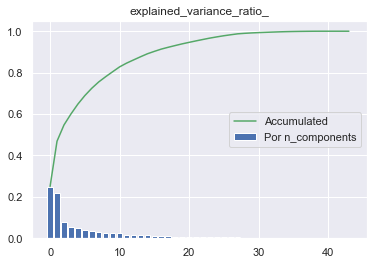

In [7]:
for n in (np.arange(1,45)):
    #Entreno el PCA
    pca = PCA(n_components=n)
    df3_new=pca.fit_transform(df3)
    
    
    print('n_components = ',n,f' Contiene un {pca.explained_variance_ratio_[-1] * 100} % de informacion')
    print()
    #print('explained variance ratio   ',pca.explained_variance_ratio_)
    print('Informacion que contiene este dataset: ' , pca.explained_variance_ratio_.sum()*100,'%' )
    print()
## ploteo grafico de barras
plt.bar(x=np.arange(n),height=pca.explained_variance_ratio_,label='Por n_components')

## Creo curva acumulada y la ploteo
explained_variance_acc=pd.Series(pca.explained_variance_ratio_).cumsum()
plt.plot(np.arange(n),explained_variance_acc,label='Accumulated',c='g')

plt.title('explained_variance_ratio_')
plt.legend(loc='center right')
plt.show()

PC  1
cantidad_reescalado     0.419595
clase_cafe              0.140802
turno_Morning [7-12]    0.076038
clase_agua              0.074615
turno_Tarde [16-20]     0.074089
Name: 0, dtype: float64


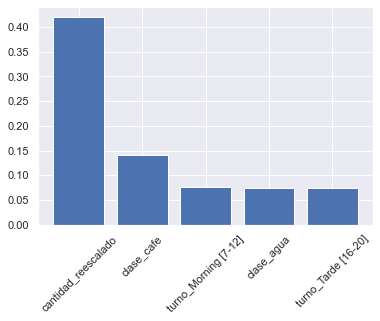

PC  2
cantidad_reescalado     0.905025
precio_reescalado       0.394611
turno_Noche [21-end]    0.092256
clase_lomo              0.042215
dia_Saturday            0.032015
Name: 1, dtype: float64


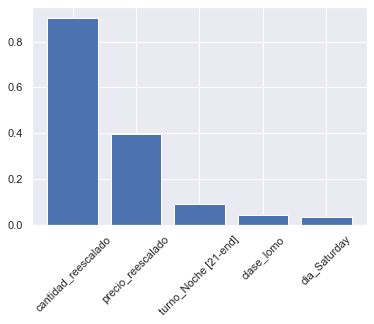

PC  3
turno_Mediodia [12-16]    0.690720
dia_Sunday                0.303354
precio_reescalado         0.106572
clase_milanesa            0.050278
cantidad_reescalado       0.038633
Name: 2, dtype: float64


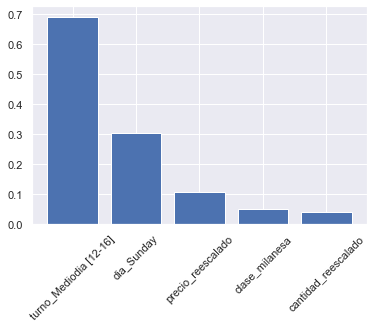

PC  4
turno_Tarde [16-20]     0.696310
dia_Sunday              0.257367
precio_reescalado       0.130237
turno_Morning [7-12]    0.103348
clase_bebidas frias     0.101831
Name: 3, dtype: float64


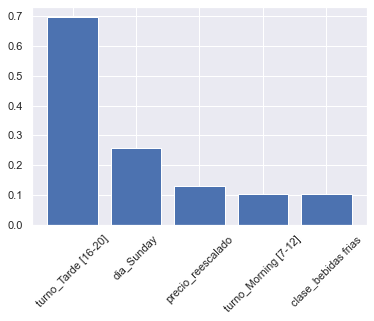

PC  5
dia_Sunday              0.683177
turno_Noche [21-end]    0.260968
clase_empanada          0.039270
turno_Morning [7-12]    0.037658
cantidad_reescalado     0.025891
Name: 4, dtype: float64


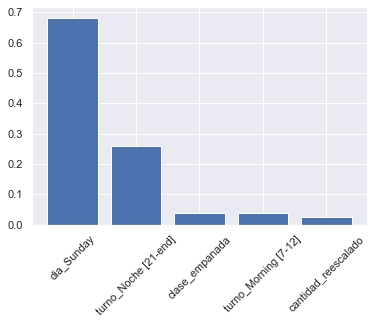

PC  6
dia_Friday                0.674467
turno_Tarde [16-20]       0.241553
turno_Mediodia [12-16]    0.134519
clase_agua                0.119372
clase_bebidas frias       0.077331
Name: 5, dtype: float64


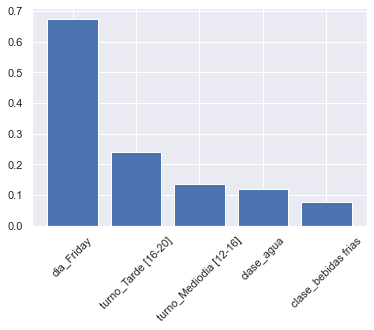

PC  7
clase_cafe              0.568424
turno_Morning [7-12]    0.494463
dia_Friday              0.240034
precio_reescalado       0.134546
dia_Thursday            0.120426
Name: 6, dtype: float64


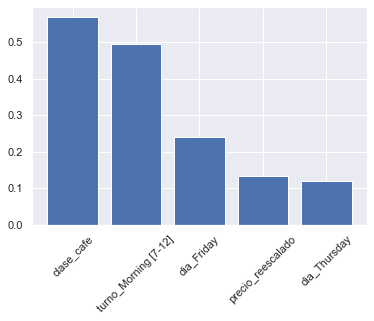

PC  8
dia_Tuesday            0.386866
dia_Thursday           0.365402
dia_Wednesday          0.358273
dia_Monday             0.115259
turno_Tarde [16-20]    0.093199
Name: 7, dtype: float64


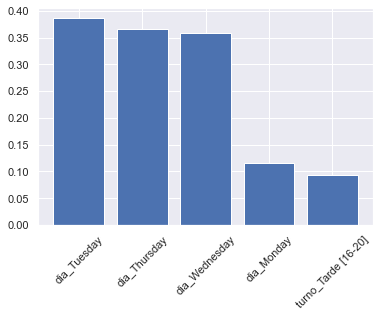

PC  9
turno_Morning [7-12]    0.544108
clase_otros_desayuno    0.328652
clase_desayunos         0.184406
dia_Thursday            0.152939
clase_agua              0.126463
Name: 8, dtype: float64


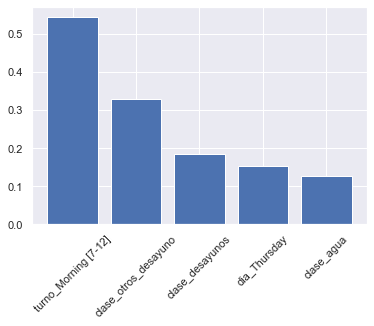

PC  10
dia_Tuesday             0.653543
turno_Morning [7-12]    0.106459
clase_otros_desayuno    0.099643
dia_Wednesday           0.057944
clase_empanada          0.035837
Name: 9, dtype: float64


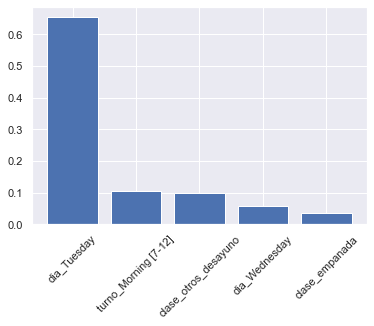

PC  11
dia_Wednesday           0.818938
turno_Morning [7-12]    0.044191
clase_otros_desayuno    0.035511
clase_desayunos         0.029502
clase_empanada          0.014665
Name: 10, dtype: float64


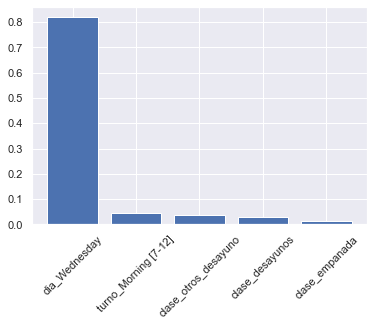

PC  12
clase_bebidas frias       0.813163
dia_Monday                0.188755
turno_Noche [21-end]      0.057710
turno_Mediodia [12-16]    0.048694
clase_empanada            0.035635
Name: 11, dtype: float64


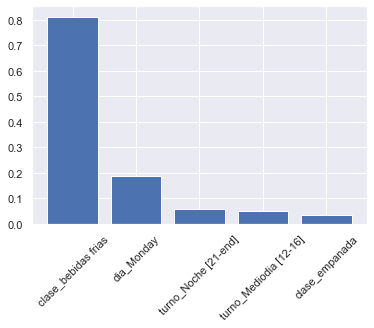

PC  13
clase_agua              0.669224
clase_bebidas frias     0.370640
turno_Morning [7-12]    0.146231
dia_Monday              0.132691
clase_cafe              0.120704
Name: 12, dtype: float64


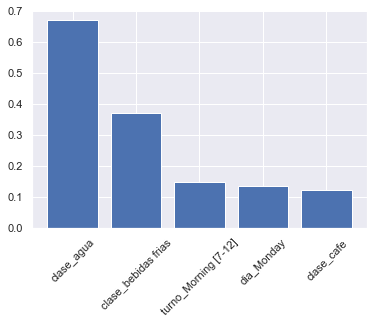

PC  14
dia_Monday              0.883915
clase_wrap              0.068732
clase_otros_desayuno    0.064838
clase_picoteo           0.053632
turno_Tarde [16-20]     0.042839
Name: 13, dtype: float64


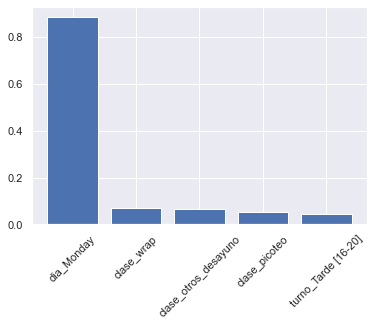

PC  15
clase_lomo              0.875034
clase_otros_desayuno    0.145452
clase_cola              0.067354
clase_bebidas frias     0.064991
dia_Monday              0.048285
Name: 14, dtype: float64


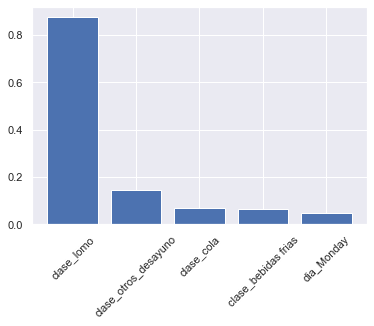

PC  16
clase_wrap              0.813585
clase_lomo              0.274157
clase_otros_desayuno    0.142555
clase_agua              0.091329
clase_bebidas frias     0.088844
Name: 15, dtype: float64


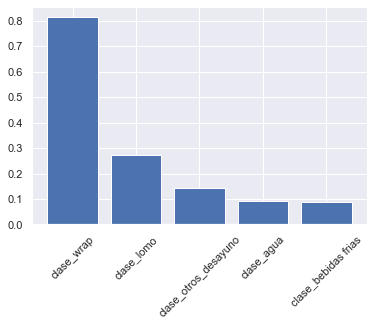

PC  17
clase_cola              0.582761
clase_desayunos         0.325330
clase_wrap              0.258048
clase_lomo              0.148678
turno_Morning [7-12]    0.112949
Name: 16, dtype: float64


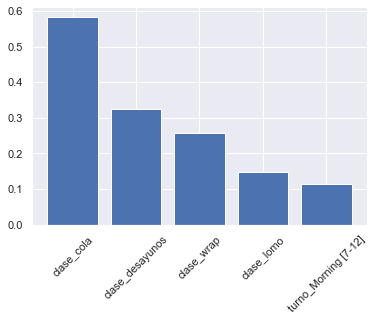

PC  18
clase_papas        0.588917
clase_postre       0.280887
clase_desayunos    0.276671
clase_empanada     0.250573
clase_lomo         0.054387
Name: 17, dtype: float64


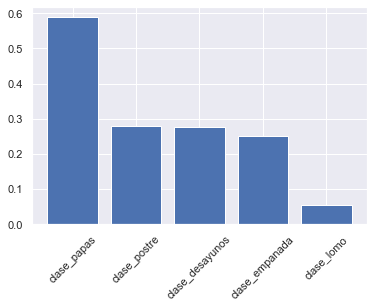

PC  19
clase_milanesa     0.889752
clase_wrap         0.090001
clase_desayunos    0.081033
clase_lomo         0.066530
clase_empanada     0.042306
Name: 18, dtype: float64


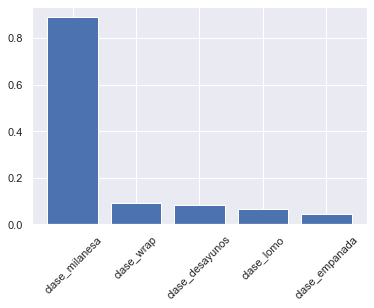

PC  20
clase_papas       0.686162
clase_cola        0.220630
clase_milanesa    0.162535
clase_agua        0.092738
clase_wrap        0.063055
Name: 19, dtype: float64


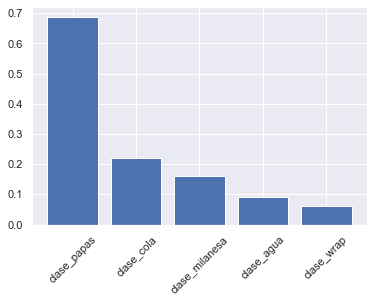

PC  21
clase_picoteo        0.751688
clase_empanada       0.208011
clase_hamburguesa    0.128565
clase_ojo de bife    0.051004
clase_pastas         0.036802
Name: 20, dtype: float64


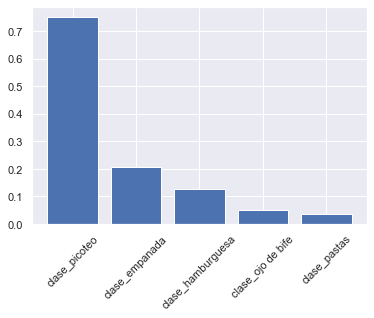

PC  22
clase_postre            0.556974
clase_picoteo           0.312750
clase_cola              0.118286
clase_papas             0.102430
turno_Morning [7-12]    0.077678
Name: 21, dtype: float64


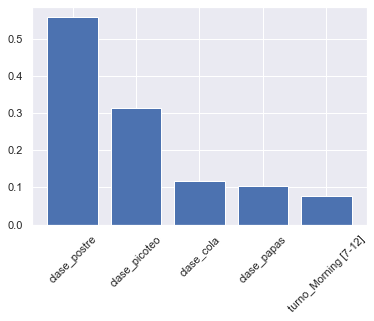

PC  23
clase_hamburguesa       0.644803
clase_baguette          0.300085
clase_desayunos         0.089935
clase_ojo de bife       0.088506
clase_otros_desayuno    0.059598
Name: 22, dtype: float64


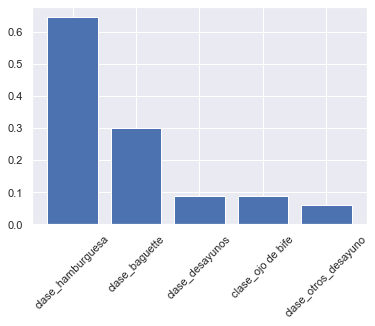

PC  24
clase_baguette          0.762935
clase_empanada          0.158820
turno_Morning [7-12]    0.153586
clase_pizza             0.071957
dia_Wednesday           0.016251
Name: 23, dtype: float64


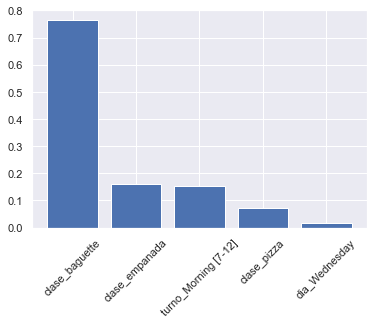

PC  25
clase_hamburguesa       0.607251
clase_empanada          0.267682
clase_pizza             0.267008
turno_Morning [7-12]    0.125500
clase_milanesa          0.119542
Name: 24, dtype: float64


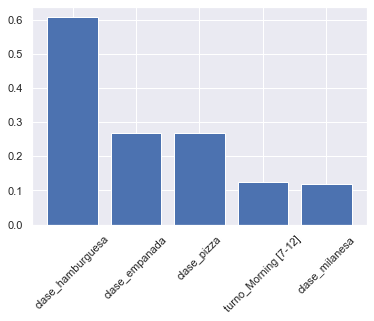

PC  26
clase_ojo de bife    0.563761
clase_empanada       0.462070
clase_postre         0.144800
clase_ensalada       0.104653
clase_cola           0.102841
Name: 25, dtype: float64


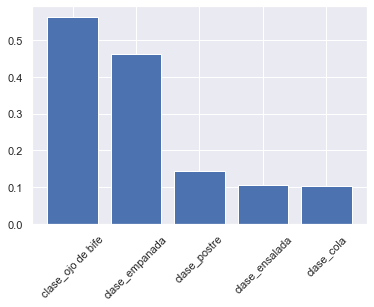

PC  27
clase_ensalada          0.871777
clase_pastas            0.105457
turno_Morning [7-12]    0.038386
turno_Tarde [16-20]     0.023260
clase_empanada          0.019220
Name: 26, dtype: float64


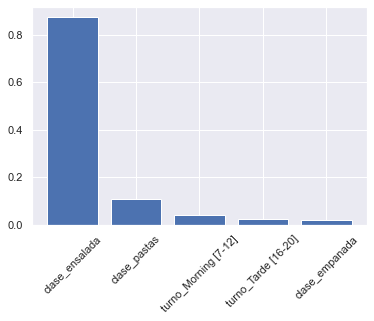

PC  28
clase_pastas            0.928736
clase_empanada          0.029774
turno_Morning [7-12]    0.027435
turno_Tarde [16-20]     0.024201
dia_Thursday            0.018019
Name: 27, dtype: float64


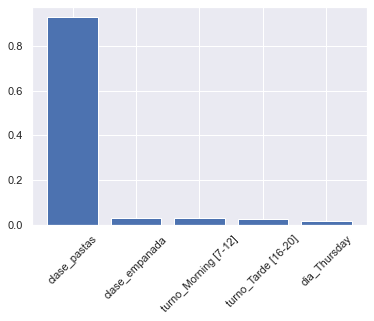

PC  29
clase_suprema      0.486870
clase_pollo        0.312314
clase_rissoto      0.205865
clase_salmon       0.184017
clase_provoleta    0.152610
Name: 28, dtype: float64


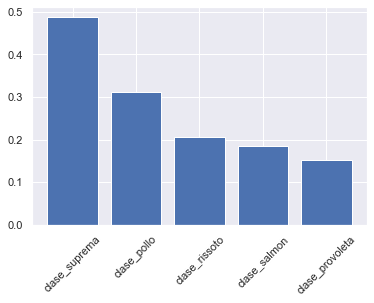

PC  30
clase_suprema        0.839286
clase_ojo de bife    0.176184
clase_pizza          0.093487
clase_ensalada       0.072946
clase_hamburguesa    0.067762
Name: 29, dtype: float64


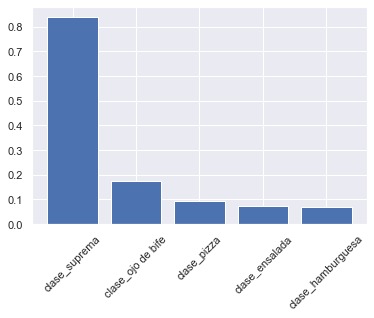

PC  31
clase_pollo          0.741971
clase_suprema        0.087269
clase_ojo de bife    0.073854
clase_pizza          0.043189
clase_ensalada       0.036401
Name: 30, dtype: float64


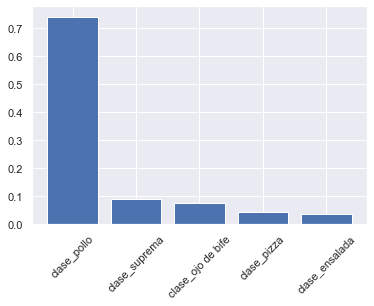

PC  32
clase_rissoto        0.677057
clase_pollo          0.366726
clase_ojo de bife    0.114682
clase_suprema        0.078246
clase_pizza          0.061043
Name: 31, dtype: float64


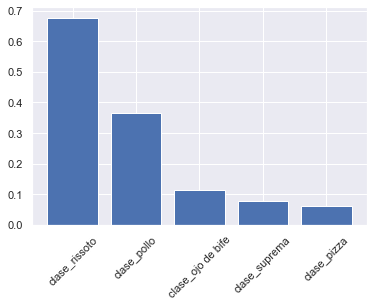

PC  33
clase_hamburguesa veggie    0.922765
clase_menu infantil         0.095812
clase_pollo                 0.078626
clase_rissoto               0.049944
clase_ojo de bife           0.048104
Name: 32, dtype: float64


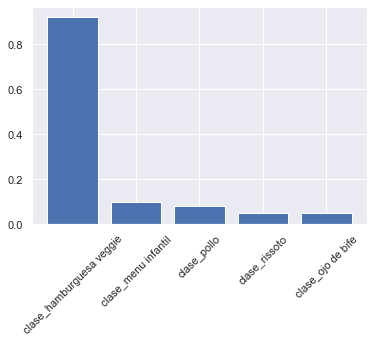

PC  34
clase_provoleta        0.801767
clase_pollo            0.155345
clase_rissoto          0.147272
clase_menu infantil    0.133111
clase_ojo de bife      0.094382
Name: 33, dtype: float64


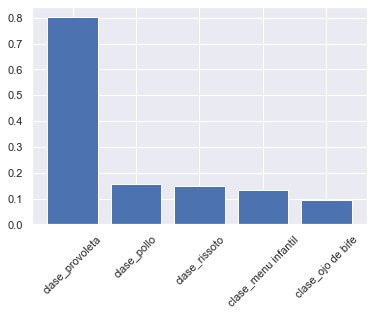

PC  35
clase_menu infantil         0.952163
clase_salmon                0.127376
clase_omelette              0.038363
clase_matambre              0.025658
clase_otros_acompanantes    0.024913
Name: 34, dtype: float64


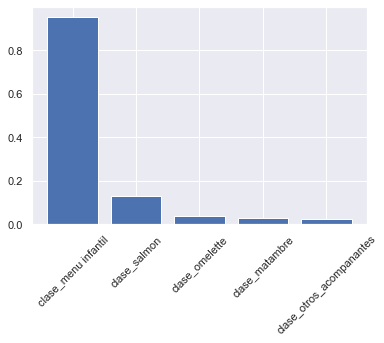

PC  36
clase_matambre          0.706539
clase_otros_desayuno    0.094450
clase_empanada          0.092944
clase_agua              0.085291
clase_cola              0.083528
Name: 35, dtype: float64


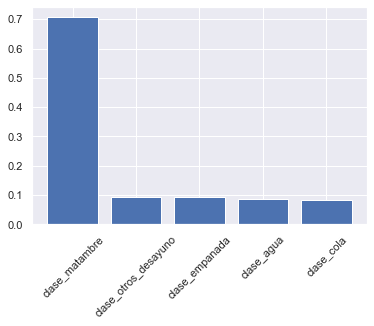

PC  37
clase_omelette              0.752612
clase_matambre              0.409217
clase_otros_acompanantes    0.260258
clase_salmon                0.184437
clase_ojo de bife           0.027589
Name: 36, dtype: float64


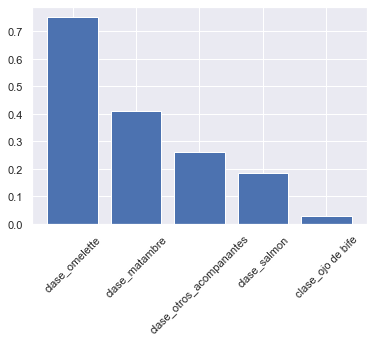

PC  38
clase_otros_acompanantes    0.574774
clase_matambre              0.358929
clase_salmon                0.265530
clase_ojo de bife           0.083968
clase_pollo                 0.061040
Name: 37, dtype: float64


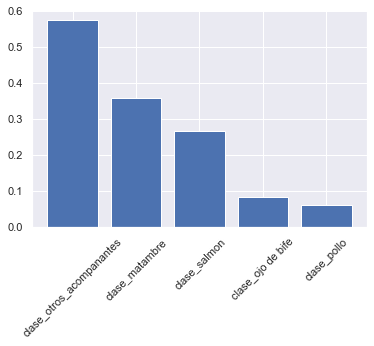

PC  39
clase_otros_acompanantes    0.743533
clase_omelette              0.138597
clase_otros_desayuno        0.132255
clase_empanada              0.127003
clase_agua                  0.122040
Name: 38, dtype: float64


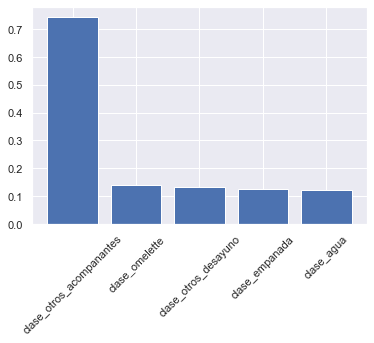

PC  40
clase_fanta          0.981461
precio_reescalado    0.008304
clase_sandwich       0.004694
dia_Thursday         0.000441
dia_Friday           0.000401
Name: 39, dtype: float64


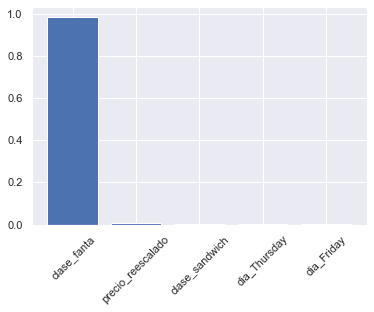

PC  41
clase_sandwich            0.983726
turno_Mediodia [12-16]    0.000123
turno_Noche [21-end]      0.000099
dia_Friday                0.000035
dia_Monday                0.000033
Name: 40, dtype: float64


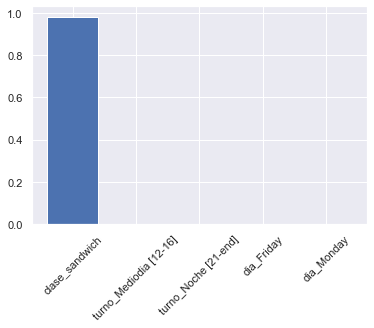

PC  42
dia_Saturday    0.370702
dia_Sunday      0.370702
dia_Thursday    0.370702
dia_Monday      0.370702
dia_Friday      0.370702
Name: 41, dtype: float64


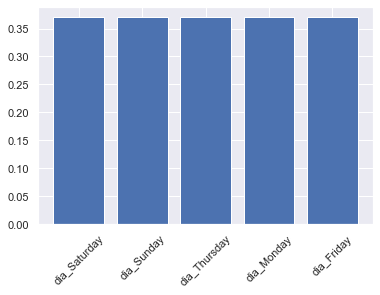

PC  43
clase_pizza            0.177596
clase_bebidas frias    0.177596
clase_provoleta        0.177596
clase_ojo de bife      0.177596
clase_sandwich         0.177596
Name: 42, dtype: float64


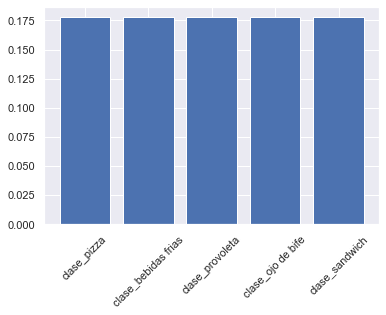

PC  44
dia_Saturday    0.073738
dia_Sunday      0.073738
dia_Thursday    0.073738
dia_Monday      0.073738
dia_Friday      0.073738
Name: 43, dtype: float64


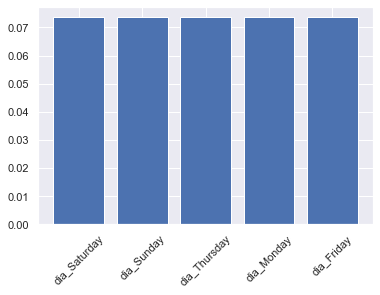

In [134]:
n=44
pca = PCA(n_components=n)
df3_new=pca.fit_transform(df3)

components_pc=pd.DataFrame(data=pca.components_,columns=df3.columns,index=np.arange(n))
components_pc=components_pc.transpose()
for i in range(n):
    pc=components_pc.sort_values(by=i,ascending=False).abs().iloc[0:5,i]

    print('PC ' , i+1)
    print(pc)
    plt.bar(x=pc.index,height=pc)
    plt.xticks(rotation=45)
    plt.show()


Usaremos n=21 que es lo que contiene un 95% de informacion del dataset, reduciendolo a la mitad

In [9]:
n=21
pca = PCA(n_components=n)
df3_new=pca.fit_transform(df3)

In [10]:
df3_new=pd.DataFrame(df3_new,index= df3.index,columns=np.arange(1,22))

Realizamos Pairplot por curiosidad de como se relacionan las variables creadas y ver si se repite algun patron.

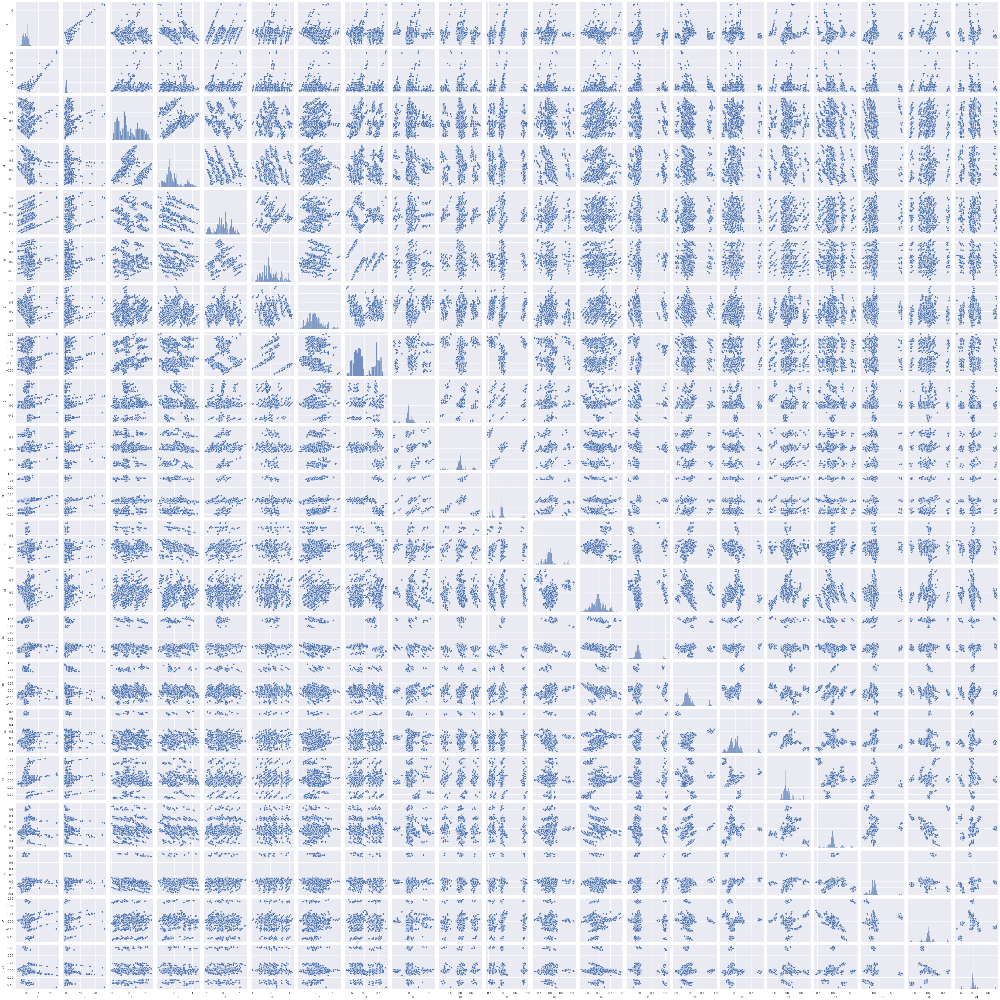

In [142]:
sns.pairplot(df3_new)

### Procedemos a evaluar el Clustering

In [148]:
km = KMeans(n_clusters=2)
km = km.fit(df3_new)
# Tomamos la suma de las distancias para todas las instancias del dataset
distancia_total = km.inertia_
print(distancia_total/df3.shape[0])

3.3922821472117834


In [159]:
# Preparamos una lista donde vamos a ir agregando las distancias medias
lista_distancias_medias = []
# Entrenamos un modelo para cada numero de cluster que queremos testear
K = np.arange(2,15)
for k in K:
    # Definimos y entrenamos el modelo
    km = KMeans(n_clusters=k)
    km = km.fit(df3_new)
    # Tomamos la suma de las distancias para todas las instancias del dataset
    distancia_total = km.inertia_
    # Calculamos la distancia media y agregamos a la lista
    distancia_media = distancia_total/df3_new.shape[0]
    lista_distancias_medias.append(distancia_media)

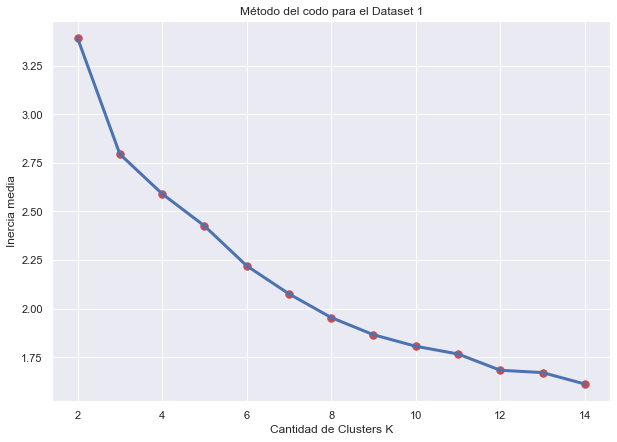

In [161]:
plt.figure(figsize = (10,7))
# Graficamos una linea continua y tambien unos puntos para resaltar los valores enteros de K.
plt.plot(K,lista_distancias_medias, lw=3)
plt.scatter(x=K,y=lista_distancias_medias,s=55,c='r')
plt.xlabel('Cantidad de Clusters K')
plt.ylabel('Inercia media')
plt.title('Método del codo para el Dataset 1')

plt.show()

A simple vista parece ser 3 Cluster donde se encuentra el ELbow.

#### Probamos con Silhouette Score

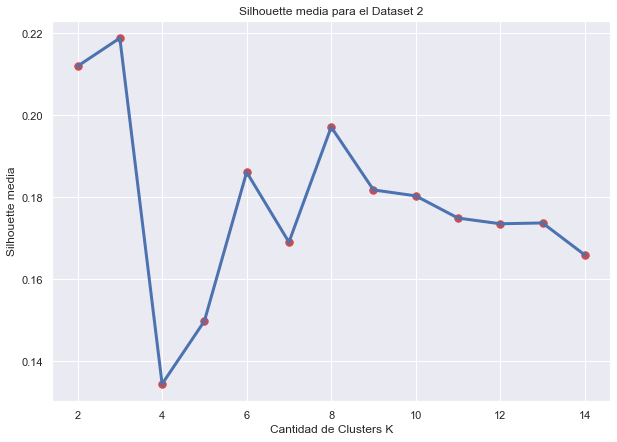

In [163]:
# Preparamos una lista donde vamos a ir agregando los valores medios de silhouette
lista_sil = []
# Fiteammos un modelo para cada numero de cluster que queremos testear
for k in K:
    # Definimos y entrenamos el modelo
    km = KMeans(n_clusters=k)
    km = km.fit(df3_new)
    
    # Tomamos las etiquetas
    etiquetas = km.labels_
    
    # Calculamos el silhouette 
    valor_medio_sil = silhouette_score(df3_new, etiquetas)
    lista_sil.append(valor_medio_sil)
    
plt.figure(figsize = (10,7))
plt.plot(K, lista_sil, lw=3)
plt.scatter(K, lista_sil,s=55,c='r')
plt.xlabel('Cantidad de Clusters K')
plt.ylabel('Silhouette media')
plt.title('Silhouette media para el Dataset 2')

plt.show()

Claramente el mejor Silhouette score se encuentra  en 3

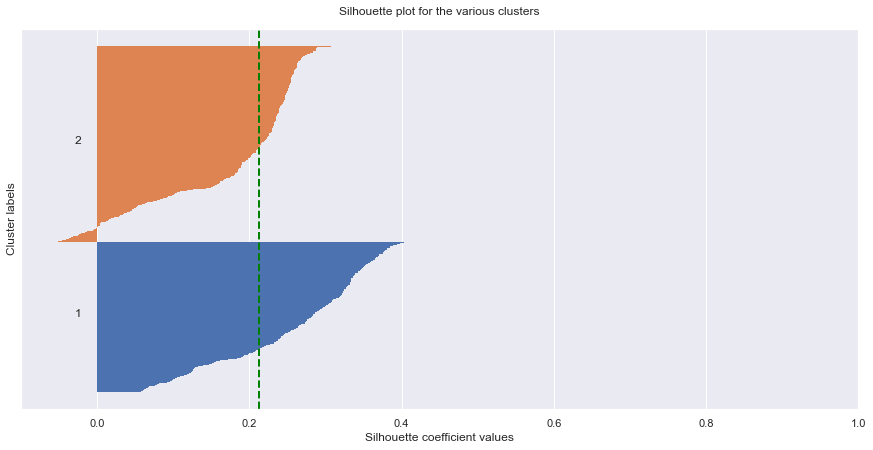

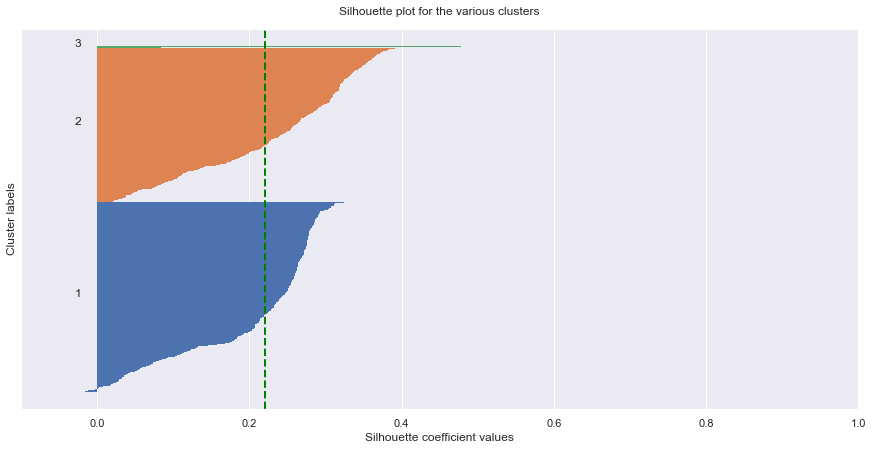

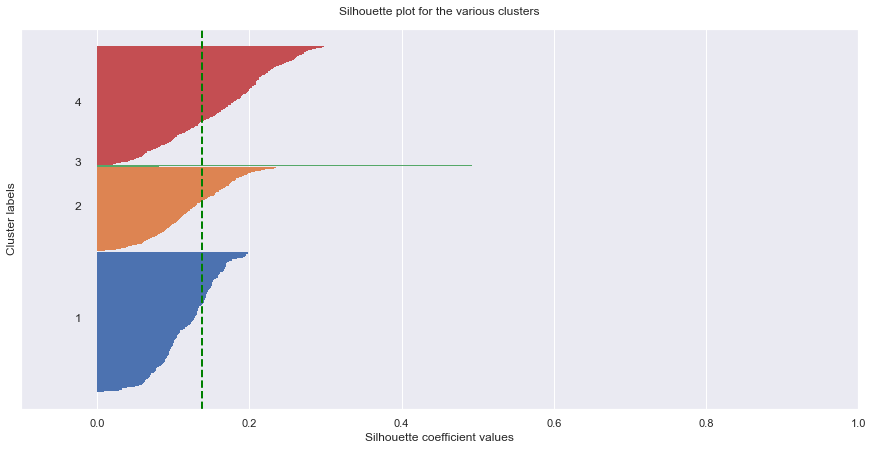

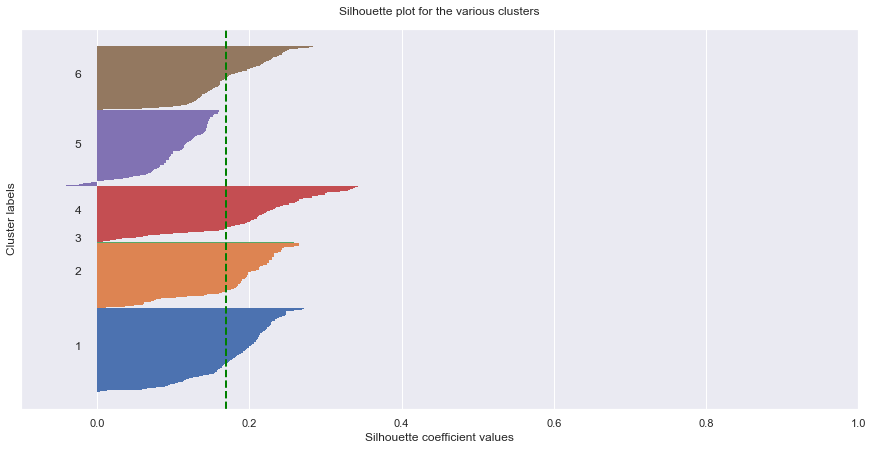

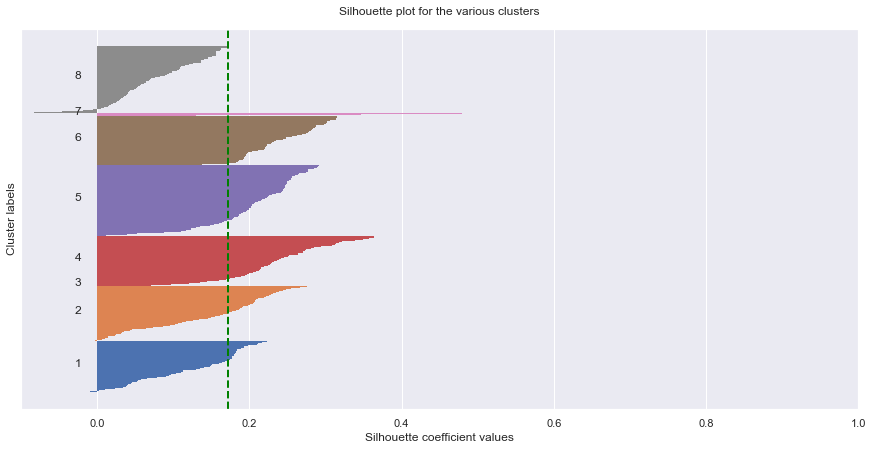

In [169]:
X_std=df3_new
lista_k= [2,3,4, 6, 8]

for i, k in enumerate(lista_k):
    fig, ax1 = plt.subplots(1, 1)
    fig.set_size_inches(15, 7)
    
    # Run the Kmeans algorithm
    km = KMeans(n_clusters=k)
    labels = km.fit_predict(X_std)
    centroids = km.cluster_centers_

    # Get silhouette samples
    silhouette_vals = silhouette_samples(X_std, labels)

    # Silhouette plot
    y_ticks = []
    y_lower, y_upper = 0, 0
    for i, cluster in enumerate(np.unique(labels)):
        cluster_silhouette_vals = silhouette_vals[labels == cluster]
        cluster_silhouette_vals.sort()
        y_upper += len(cluster_silhouette_vals)
        ax1.barh(range(y_lower, y_upper), cluster_silhouette_vals, edgecolor='none', height=1)
        ax1.text(-0.03, (y_lower + y_upper) / 2, str(i + 1))
        y_lower += len(cluster_silhouette_vals)

    # Get the average silhouette score and plot it
    avg_score = np.mean(silhouette_vals)
    ax1.axvline(avg_score, linestyle='--', linewidth=2, color='green')
    ax1.set_yticks([])
    ax1.set_xlim([-0.1, 1])
    ax1.set_xlabel('Silhouette coefficient values')
    ax1.set_ylabel('Cluster labels')
    ax1.set_title('Silhouette plot for the various clusters', y=1.02);

Parece ser qie el k =3 tiene ciertas instancias alejadas que se agrupan en otro cluster que no llega a tener muchas instancias. Pero esto genera un mejor silhouette score.
Podriamos buscar dichas instancias y eliminarlas pero procederemos de otra forma

**Voy a usar k =2 ya que parece lo mas razonable**

In [11]:
km = KMeans(n_clusters=2)
km = km.fit(df3_new)
    
# Tomamos las etiquetas
etiquetas = km.labels_

In [12]:
df3_new['label']=etiquetas

In [14]:
df2['label']=etiquetas

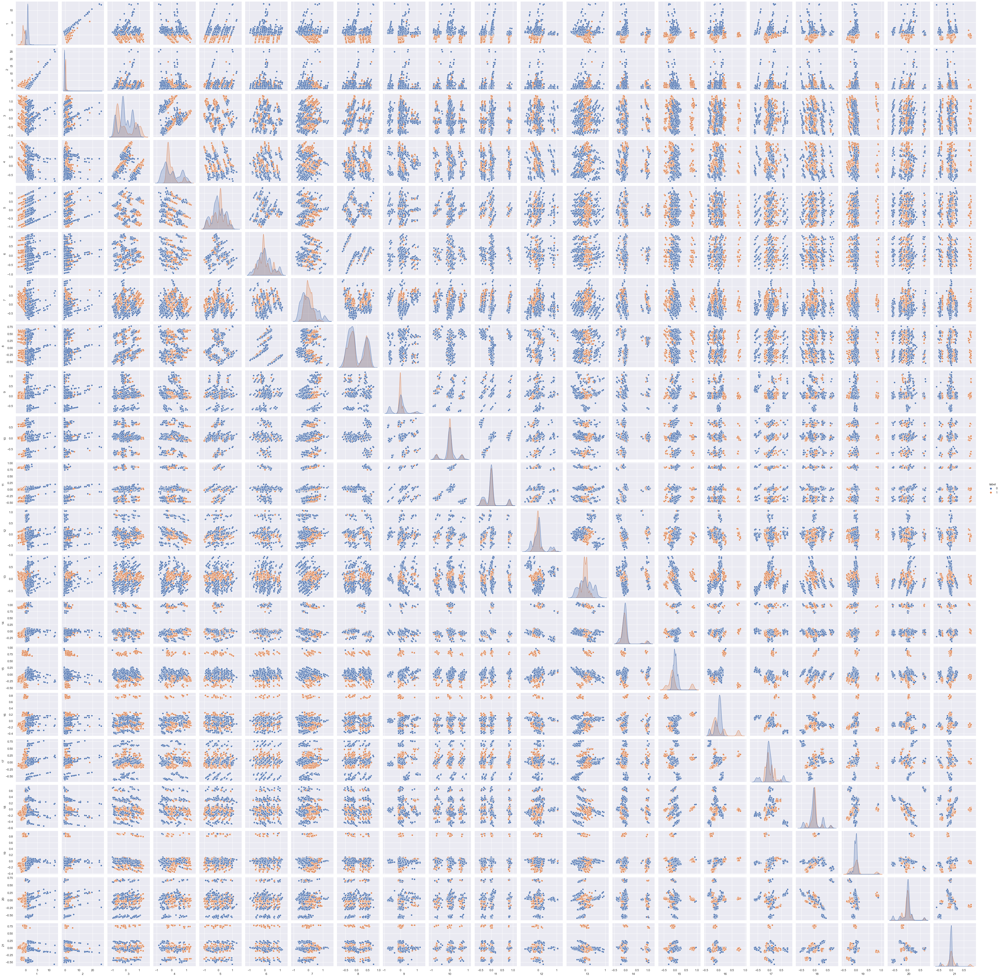

In [177]:
#sns.pairplot(df3_new,hue='label')

### Analisis exploratorio de Clustering

C:\Users\Octavio\miniconda3\envs\datascience\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='label', ylabel='count'>

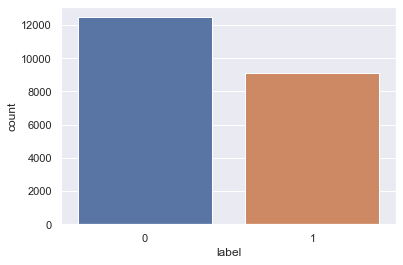

In [15]:
sns.countplot(df2.label)

<AxesSubplot:xlabel='descrip', ylabel='clase'>

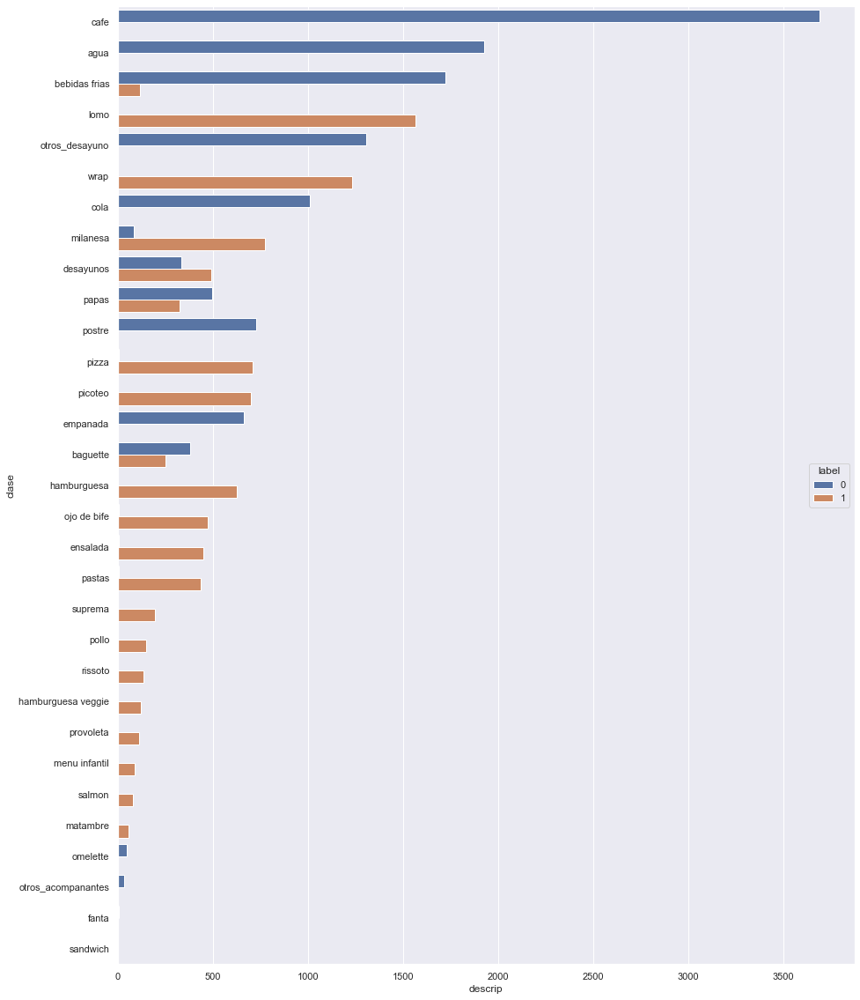

In [16]:
plt.figure(figsize=[15,20])
sns.barplot(y=df2.groupby(['clase','label']).descrip.count().reset_index().clase,x=df2.groupby(['clase','label']).descrip.count().reset_index().descrip,hue=df2.groupby(['clase','label']).descrip.count().reset_index().label,order=df2.clase.value_counts().index)

Claramente vemos que la clusterizacion principal es de bebidas por un lado y comidas por otro. Tambien junto a bebidas se encuentran clases que son de tipo desayuno o merienda.

Monday


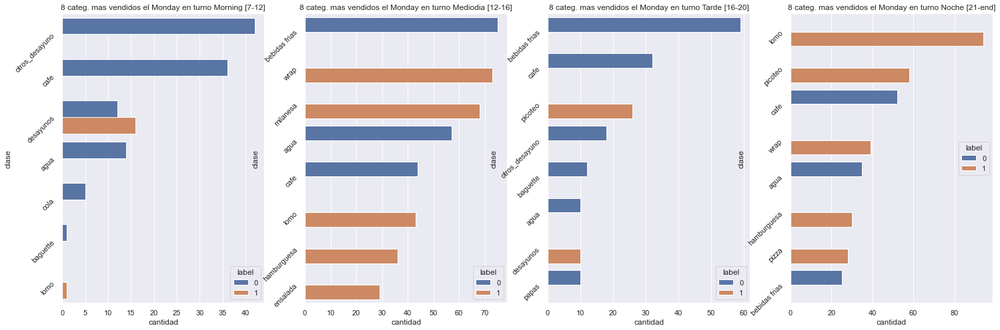

Tuesday


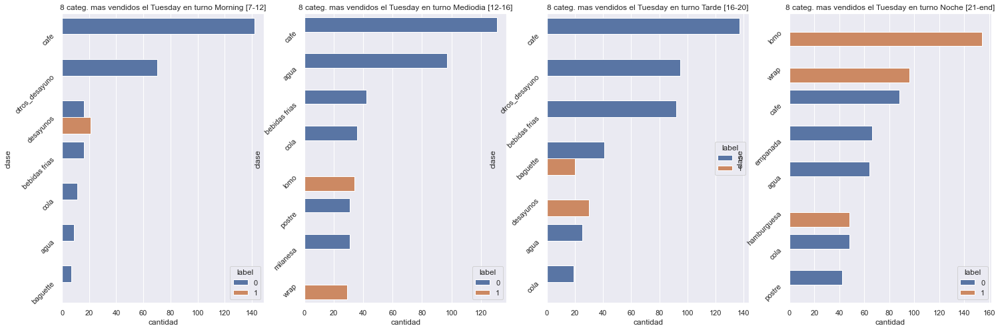

Wednesday


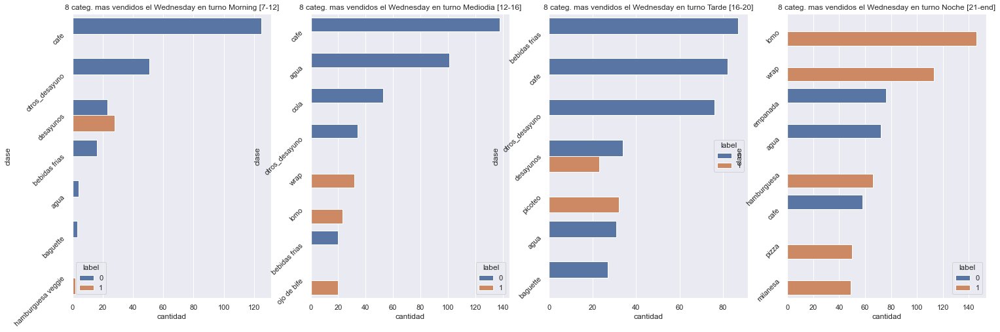

Thursday


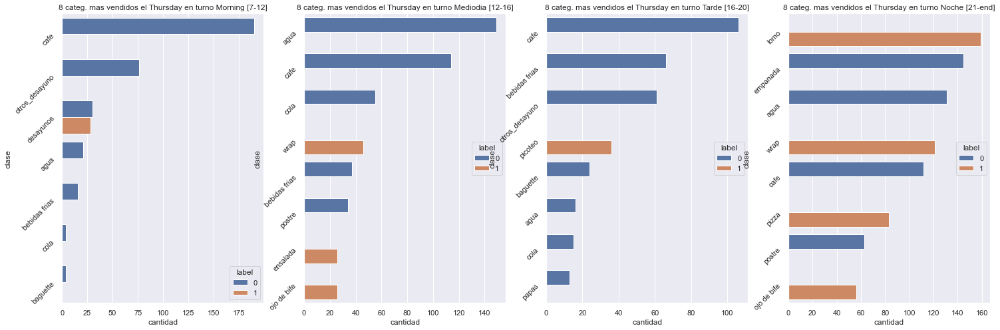

Friday


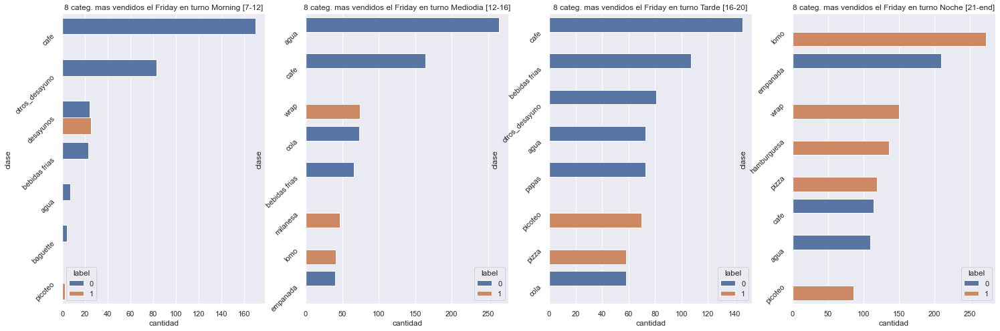

Saturday


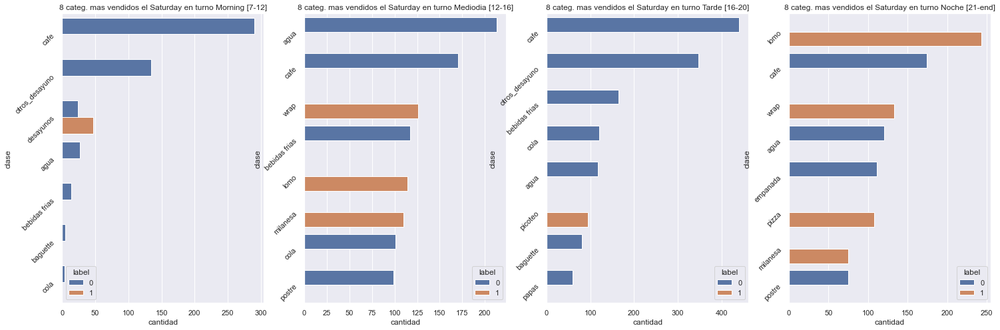

Sunday


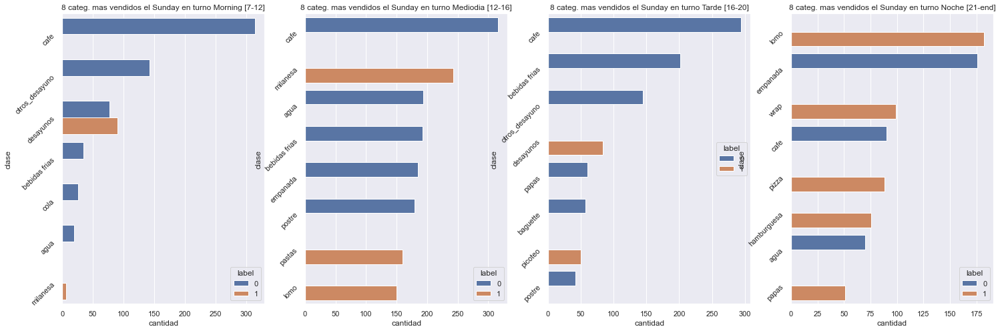

In [17]:
semana=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
turno=['Morning [7-12]', 'Mediodia [12-16]','Tarde [16-20]','Noche [21-end]']
for dia in semana:
    graf=df2.loc[df2.dia==dia].groupby(['clase','turno','dia','label']).cantidad.sum().sort_values(ascending=False).reset_index()
    print(dia)
    plt.figure(figsize=[25,8])
    
    rotation=45
    
    idx=0
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad',hue='label')

    idx=1
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad',hue='label')

    idx=2
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad',hue='label')

    idx=3
    title=f'8 categ. mas vendidos el {dia} en turno {turno[idx]}'
    plt.subplot(1,4,idx+1)
    plt.title(title)
    d=graf[graf.turno==turno[idx]].sort_values(by='cantidad',ascending=False).iloc[:8]
    plt.yticks(rotation=rotation)
    sns.barplot(data=d,y='clase',x='cantidad',hue='label')

    plt.show()

In [18]:
df2['fecha']=pd.to_datetime(df2['fecha'],format='%Y/%m/%d %H:%M:%S')

In [ ]:
plt.figure(figsize=[16,8])
sns.catplot(data=df2,y=df2.clase,x=df2.facturado_plato,hue=df2['label'],kind='bar')
plt.ylim(0,4000)
plt.show()

## Procedemos a dividir el dataset en dos segun los Labels y sacar la matriz Item N Item para cada uno a ver si hay algun insight

In [22]:
df2_cluster1=df2[df2.label==1]
df2_cluster0=df2[df2.label==0]

### Para Cluster 1

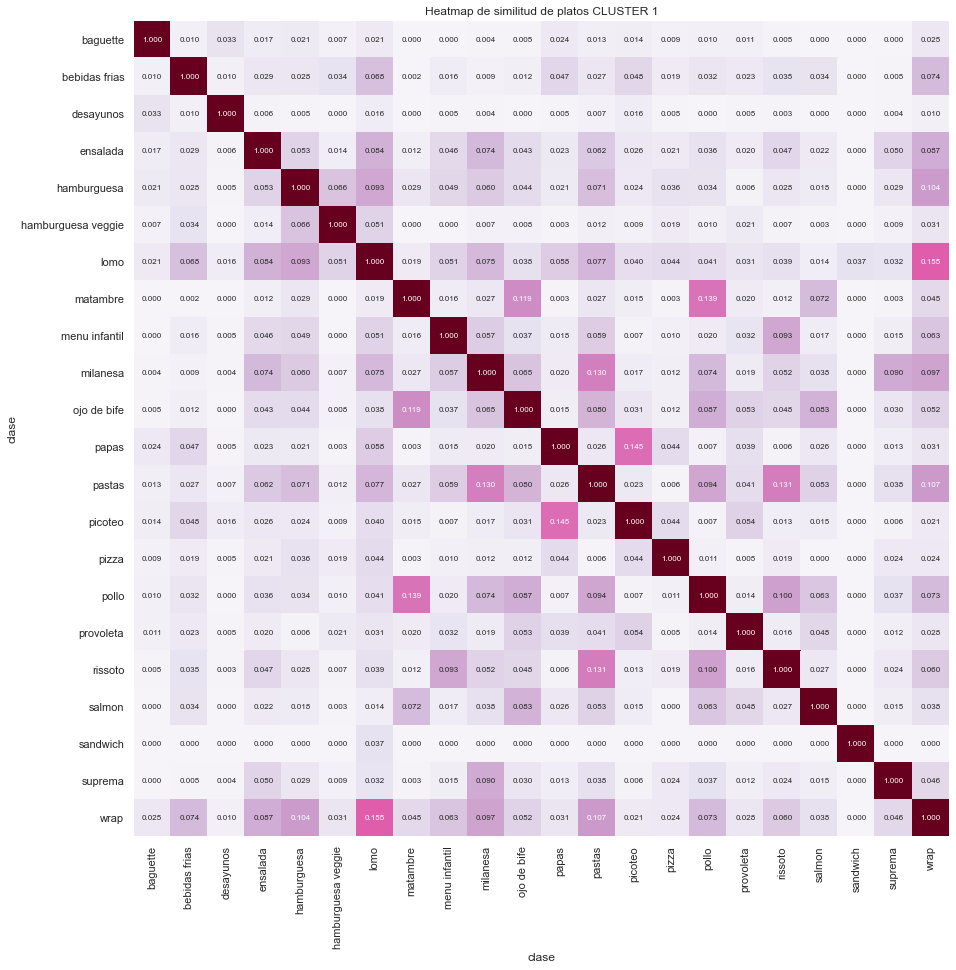

In [24]:
utility=pd.pivot_table(data=df2_cluster1,columns='clase',index='ticket',values='cantidad',aggfunc='sum',fill_value=0)

### Modulo de vector de tickets
ticket_magnitude =np.sqrt(np.square(utility).sum(axis=1))
### Normalizo Vectores
utility_norm=utility.divide(ticket_magnitude, axis='index')

### calculo modulo de vector de items o platos para usarlo para calcular similitud coseno
item_magnitude_norm = np.sqrt(np.square(utility_norm).sum(axis=0))

### Creo matriz item n item con valores de similitud
item_item=pd.DataFrame(data=np.zeros([utility_norm.shape[1],utility_norm.shape[1]]),index=utility_norm.columns,columns=utility_norm.columns)

for i in item_item.columns:
    for j in item_item.index:
        dot=np.dot(utility_norm[i].values,utility_norm[j].values)
        euclidean_i=item_magnitude_norm[i]
        euclidean_j=item_magnitude_norm[j]
        value=dot/(euclidean_i*euclidean_j)
        item_item.loc[i,j]=value

##GRAFICO
plt.figure(figsize=[15,15])
plt.title('Heatmap de similitud de platos CLUSTER 1')
sns.heatmap(item_item,
            cbar = False,  square = True, annot=True, fmt= '.3f',annot_kws={'size': 8},vmin=0, vmax=0.3,cmap='PuRd')# cmap= 'coolwarm'
plt.show()

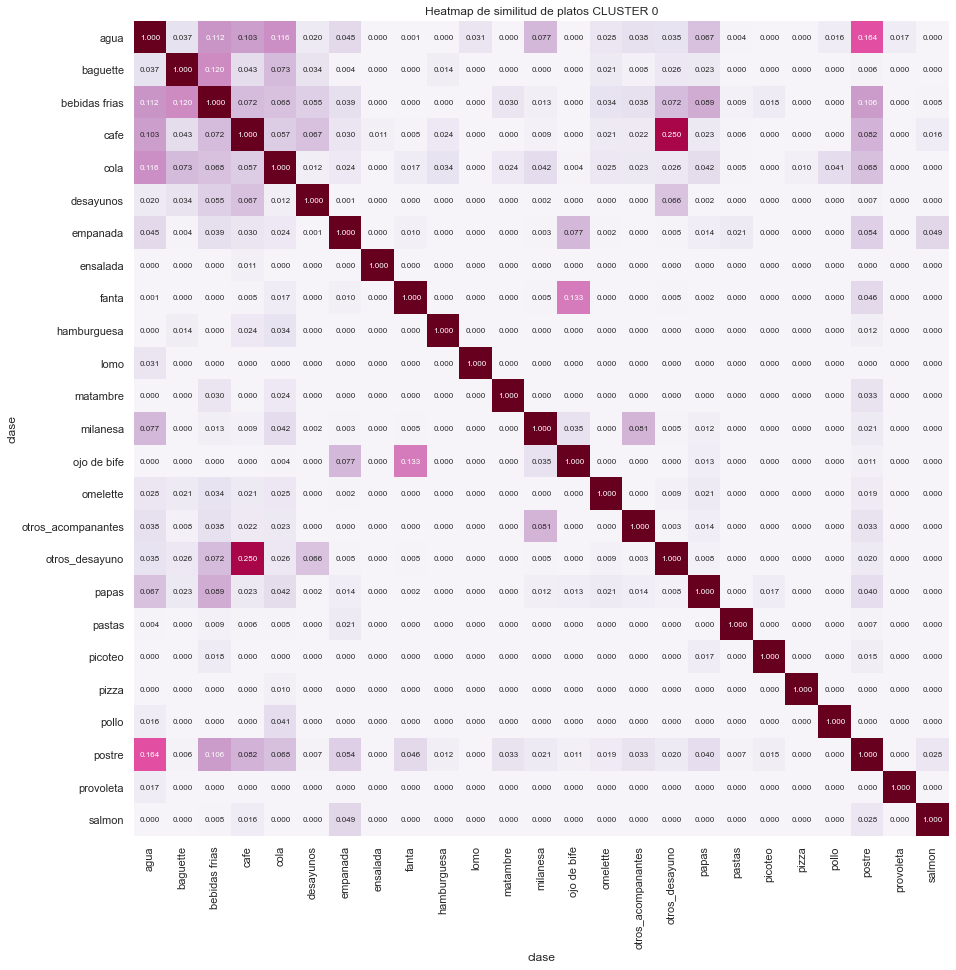

In [25]:
utility=pd.pivot_table(data=df2_cluster0,columns='clase',index='ticket',values='cantidad',aggfunc='sum',fill_value=0)

### Modulo de vector
ticket_magnitude =np.sqrt(np.square(utility).sum(axis=1))
### Normalizo Vectores
utility_norm=utility.divide(ticket_magnitude, axis='index')

### calculo modulo de vector de platos para usarlo para calcular similitud coseno
item_magnitude_norm = np.sqrt(np.square(utility_norm).sum(axis=0))

### Creo matriz item n item con valores de similitud
item_item=pd.DataFrame(data=np.zeros([utility_norm.shape[1],utility_norm.shape[1]]),index=utility_norm.columns,columns=utility_norm.columns)

for i in item_item.columns:
    for j in item_item.index:
        dot=np.dot(utility_norm[i].values,utility_norm[j].values)
        euclidean_i=item_magnitude_norm[i]
        euclidean_j=item_magnitude_norm[j]
        value=dot/(euclidean_i*euclidean_j)
        item_item.loc[i,j]=value

##GRAFICO
plt.figure(figsize=[15,15])
plt.title('Heatmap de similitud de platos CLUSTER 0')
sns.heatmap(item_item,
            cbar = False,  square = True, annot=True, fmt= '.3f',annot_kws={'size': 8},vmin=0, vmax=0.3,cmap='PuRd')# cmap= 'coolwarm'
plt.show()